In [1]:
from astropy.table import Table
import matplotlib.pyplot as plt
plt.clf()
plt.cla()
plt.close()
#Clears figure and erases it so that figures can be made later
import math
import numpy
import time
import sklearn
from sklearn.neighbors import NearestNeighbors
import scipy
from scipy  import spatial
from numpy import loadtxt
import sys
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
import pandas
#Imports possibly useful Python software to use
t=Table.read('NGC2264TGAS.vot')
#Defines t as the data table
def Assignments(Table):
    #Assigns variables from table columns and prints columns to see what there is
    #Parameter Table is the table of data
    print("The columns within this catalog are: ")
    print(t.colnames)
    #Prints out all of the column names for easy reference
    StarRA=t["RA_ICRS"]
    StarDec=t["DE_ICRS"]
    #Reads in the RA and Dec from columns in the table
    Gmag=t["__Gmag_"]
    Parallax=t["Plx"]
    ParallaxError=t["e_Plx"]
    #Reads in quantities from the data table
    return (StarRA,StarDec,Gmag,Parallax,ParallaxError);
StarRA,StarDec,Gmag,Parallax,ParallaxError=Assignments(t)

The columns within this catalog are: 
['_Glon', '_Glat', '_RAJ2000', '_DEJ2000', 'RA_ICRS', 'e_RA_ICRS', 'DE_ICRS', 'e_DE_ICRS', 'Source', 'Epoch', 'Plx', 'e_Plx', 'pmRA', 'e_pmRA', 'pmDE', 'e_pmDE', 'Dup', '__Gmag_', 'GLON', 'GLAT']


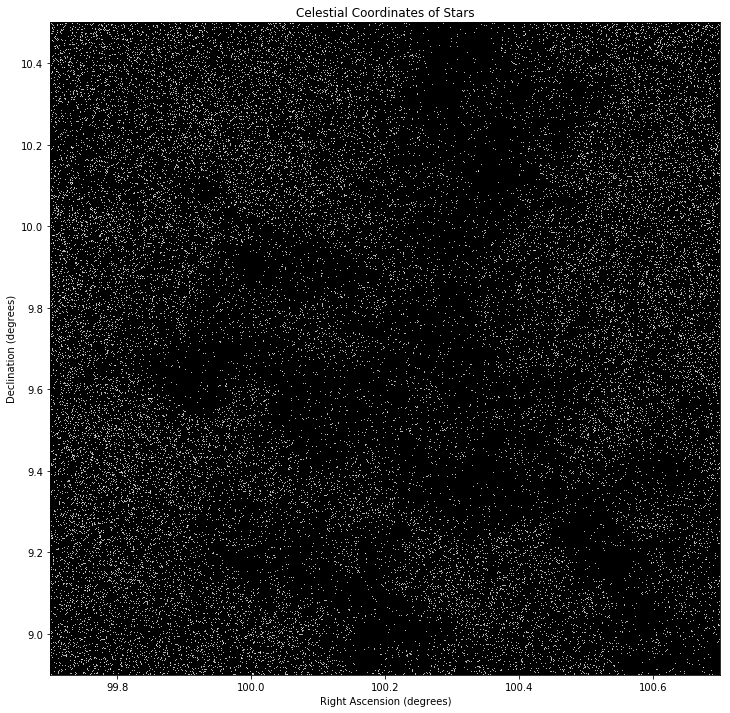

In [2]:
RAMin=99.70
RAMax=100.70
DecMin=8.90
DecMax=10.50
def SkyRegionPlot(StarRA,StarDec,RAMin,RAMax,DecMin,DecMax):
    #Creates a plot (picture) of the locations of stars in this region of sky
    #Parameter StarRA is the star right ascension array
    #Parameter StarDec is the star declination array
    #Parameter RAMin is the minimum right ascension limit
    #Parameter RAMax is the maximum right ascension limit
    #Parameter DecMin is the minimum declination limit
    #Parameter DecMax is the maximum declination limit
    plt.rcParams['axes.facecolor']='black'
    plt.rcParams['figure.figsize']=12,12
    #Sets background color and figure size
    plt.plot(StarRA,StarDec,color='xkcd:white',linestyle='None',marker='*',markersize=0.2)
    #Plots coordinates as white stars with no lines
    plt.xlabel('Right Ascension (degrees)')
    plt.ylabel('Declination (degrees)')
    plt.title('Celestial Coordinates of Stars')
    #Adds appropriate labels and title
    plt.xlim([RAMin,RAMax])
    plt.ylim([DecMin,DecMax])
    #Changes the plot limits to cut off edges
    plt.show()
    plt.clf()
    plt.cla()
    plt.close()
    #Clears figure and erases it so that figures can be made later
SkyRegionPlot(StarRA,StarDec,RAMin,RAMax,DecMin,DecMax)
#Runs function for NGC 2264

In [3]:
def PixelSetup(StarRA,StarDec,N):
    #Does math to shift and normalize arrays and makes pixels
    #Parameter StarRA is array of the star right ascensions
    #Parameter StarDec is array of the star declinations
    #Parameter N is the number of pixels desired on each side
    RAStDev=numpy.std(StarRA)
    DecStDev=numpy.std(StarDec)
    #Computes standard deviations of each array
    RAAverage=numpy.average(StarRA)
    DecAverage=numpy.average(StarDec)
    #Computes averages of each array
    RA=StarRA-RAAverage
    RA=RA/RAStDev
    Dec=StarDec-DecAverage
    Dec=Dec/DecStDev
    #Shifts and normalizes the RA and Dec so they are easy to work with
    RAPixels=numpy.linspace(RAMin,RAMax,N)
    DecPixels=numpy.linspace(DecMin,DecMax,N)
    #Creates linearly spaced pixel arrays for next step
    RAPixels=RAPixels-RAAverage
    RAPixels=RAPixels/RAStDev
    DecPixels=DecPixels-DecAverage
    DecPixels=DecPixels/DecStDev
    #Shifts and normalizes pixels to match format
    Pixels2D=numpy.zeros([N,N])
    #Makes two-dimensional pixels array for next steps
    RAPixels=numpy.asarray(RAPixels)
    DecPixels=numpy.asarray(DecPixels)
    return (RAStDev,DecStDev,RAAverage,DecAverage,RA,Dec,RAPixels,DecPixels,Pixels2D)
N=100
RAStDev,DecStDev,RAAverage,DecAverage,RA,Dec,RAPixels,DecPixels,Pixels2D=PixelSetup(StarRA,StarDec,N)

In [4]:
def NearestNeighbor2D(k):
    #Finds kth nearest neighbors in two dimensions for star array and pixel grid
    #Parameter k is kth neighbor desired
    tic=time.time()
    #Gets starting time
    Gridx=numpy.array([])
    Gridy=numpy.array([])
    #Makes empty arrays for grid values
    rows=N*N
    for i in range(0,N):
        for j in range(0,N):
            Gridx=numpy.append(Gridx,RAPixels[i])
    for i in range(0,N):
        Gridy=numpy.append(Gridy,DecPixels)
    Grid=numpy.vstack((Gridx,Gridy))
    Grid=numpy.transpose(Grid)
    #Sets up the pixel grid for calculation
    StarArray2D=numpy.vstack((RA,Dec))
    StarArray2D=numpy.transpose(StarArray2D)
    #Sets up the star array for calculation
    tree=spatial.cKDTree(StarArray2D)
    #Sets up the cKDTree structure to query through
    NumberOfNeighbors=k
    #Redefines the number of neighbors as k for function usage
    distance,indices=tree.query(Grid,k=[NumberOfNeighbors])
    #Uses cKDTree algorithm to get kth nearest neighbor distances and indices
    print('Done')
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took
    return (distance,indices);
k=10
distance,indices=NearestNeighbor2D(k)

Done
Elapsed Time: 0.13185811042785645 seconds
Elapsed Time: 0.0021976351737976072 minutes


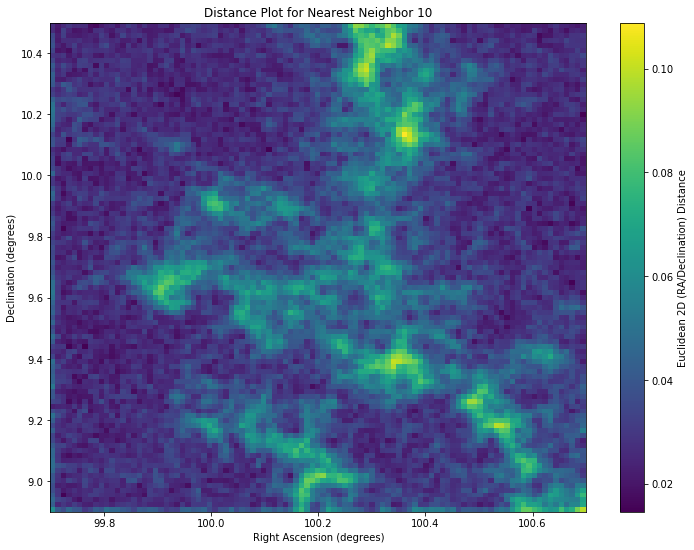

In [5]:
def DistanceMap2D():
    #Produces two-dimensional distance map with color bar and color mapping for kth nearest neighbor distances
    x=numpy.linspace(RAMin,RAMax,N)
    y=numpy.linspace(DecMin,DecMax,N)
    X,Y=numpy.meshgrid(x,y)
    #Creates grid of the original RA and Dec range
    plt.rcParams['figure.figsize']=12,9
    #Sets figure size
    distances=distance[:,0]
    Distances=numpy.reshape(distances,(-1,N))
    Distances=numpy.transpose(Distances)
    #Sets up the nearest neighbor distances for the plot
    plt.pcolormesh(X,Y,Distances,cmap='viridis')
    plt.xlabel('Right Ascension (degrees)')
    plt.ylabel('Declination (degrees)')
    plt.title('Distance Plot for Nearest Neighbor %g'%(k))
    #Sets appropriate labels and title and plots with color mapping
    cbar=plt.colorbar()
    cbar.set_label('Euclidean 2D (RA/Declination) Distance',rotation='90')
    #Makes a color bar with label
    plt.show()
    plt.clf()
    plt.cla()
    plt.close()
    #Clears figure and erases it so that figures can be made later
    return Distances;
Distances=DistanceMap2D()

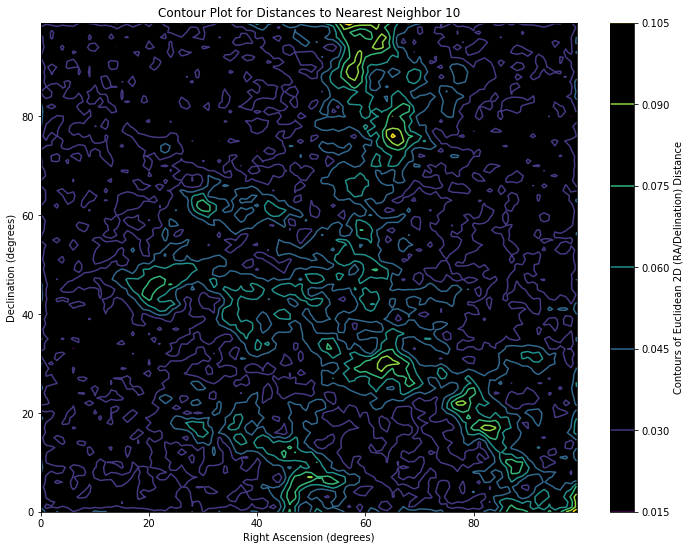

In [6]:
def DistanceMapContour2D(n):
    #Produces contour distance map of the kth nearest neighbor distances
    #Parameter n is number of contours desired
    MinimumLevel=numpy.min(Distances)
    MaximumLevel=numpy.max(Distances)
    AverageLevel=numpy.average(Distances)
    #Gets information on levels for contours
    plt.rcParams['figure.figsize']=12,9
    plt.rcParams['axes.facecolor']='black'
    #Sets figure size and background color
    plt.contour(Distances)
    cbar=plt.colorbar()
    cbar.set_label('Contours of Euclidean 2D (RA/Delination) Distance',rotation='90')
    plt.title('Contour Plot for Distances to Nearest Neighbor %g'%(k))
    plt.xlabel('Right Ascension (degrees)')
    plt.ylabel('Declination (degrees)')
    #Makes contour plot with color bar and title
    plt.show()
    plt.clf()
    plt.cla()
    plt.close()
    #Clears figure and erases it so that figures can be made later
n=10
DistanceMapContour2D(n)

In [7]:
def SpectralDistances(M):
    #Computes the distances to stars using spectral assumption
    #Parameter M is the absolute magnitude assumed to be the same for all stars
    IntermediateStep=(1/5)*(Gmag-M+5)
    tens=10*numpy.ones(len(Gmag))
    tens=numpy.transpose(tens)
    StarDistance=numpy.power(tens,IntermediateStep)
    #Calculates distance using magnitude formula assuming all have the same absolute magnitude M
    SpectralDistanceSpecial=numpy.array([])
    for i in range(0,len(StarDistance)):
        if StarDistance[i]<=1000:
            SpectralDistanceSpecial=numpy.append(SpectralDistanceSpecial,StarDistance[i])
    #Creates special array of spectral distances at or closer than 1,000 pc
    DistanceAverage=numpy.average(SpectralDistanceSpecial)
    DistanceStDev=numpy.std(SpectralDistanceSpecial)
    Distance=StarDistance-DistanceAverage
    Distance=Distance/DistanceStDev
    #Shifts and normalizes the distance star array like RA and Dec were
    return (StarDistance,DistanceAverage,DistanceStDev,Distance);
#Average absolute magnitude of F spectral type stars taken to be +2.6
#Uncertainty in this absolute F magnitude is 0.9 magnitudes
#http://adsabs.harvard.edu/full/1966AJ.....71..517M
#Average absolute magnitude of G5 spectral type main sequence stars is +5.2
#https://sites.uni.edu/morgans/astro/course/Notes/section2/spectraltemps.html
M=5.2
StarDistance,DistanceAverage,DistanceStDev,Distance=SpectralDistances(M)

In [8]:
def NearestNeighbor3D(k,DistanceMin,DistanceMax,RA,Dec,Distance):
    #Finds the kth nearest neighbor distances and indices in three dimensions using cKDTree algorithm
    #Parameter k is kth nearest neighbor desired
    #Parameter DistanceMin is the minimum distance of the range
    #Parameter DistanceMax is the maximum distance of the range
    #Parameter RA is the shifted and normalized star RA array
    #Parameter Dec is the shifted and normalized star declination array
    #Parameter Distance is the shifted and normalized star distance array
    tic=time.time()
    #Gets starting time
    DistancePixels=numpy.linspace(DistanceMin,DistanceMax,N)
    DistancePixels=DistancePixels-DistanceAverage
    DistancePixels=DistancePixels/DistanceStDev
    DistancePixels=numpy.asarray(DistancePixels)
    #Produces distance pixel array
    Pixels=numpy.zeros([N,N,N])
    StarArray=numpy.vstack((RA,Dec,Distance))
    StarArray=numpy.transpose(StarArray)
    #Prepares star location three dimensional array
    NumberOfPoints=N*N*N
    PixelArray=numpy.zeros((NumberOfPoints,3))
    i=0
    for RA in RAPixels:
        for Dec in DecPixels:
            for Distance in DistancePixels:
                PixelArray[i,0]=RA
                PixelArray[i,1]=Dec
                PixelArray[i,2]=Distance
                i+=1
    #Prepares pixel grid three dimensional array
    tree=spatial.cKDTree(StarArray)
    #Sets up the cKDTree structure to query through
    NumberOfNeighbors=k
    #Redefines the number of neighbors as k for function usage
    Distances3D,Indices3D=tree.query(PixelArray,k=[NumberOfNeighbors])
    #Uses cKDTree algorithm to get kth nearest neighbor distances and indices
    print('Done')
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (DistancePixels,StarArray,NumberOfPoints,Distances3D,Indices3D);
DistanceMin=0
DistanceMax=1000
DistancePixels,StarArray,NumberOfPoints,Distances3D,Indices3D=NearestNeighbor3D(k,DistanceMin,DistanceMax,RA,Dec,Distance)

Done
Elapsed Time: 3.364447593688965 seconds
Elapsed Time: 0.056074126561482744 minutes


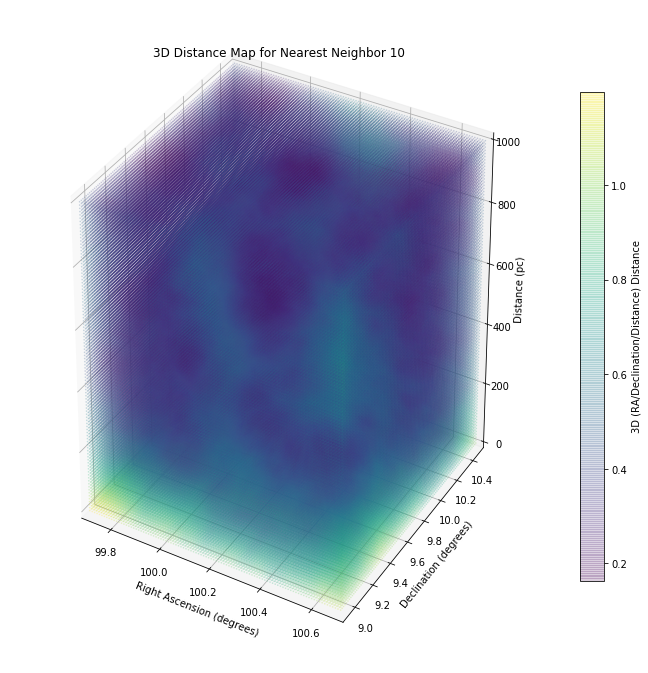

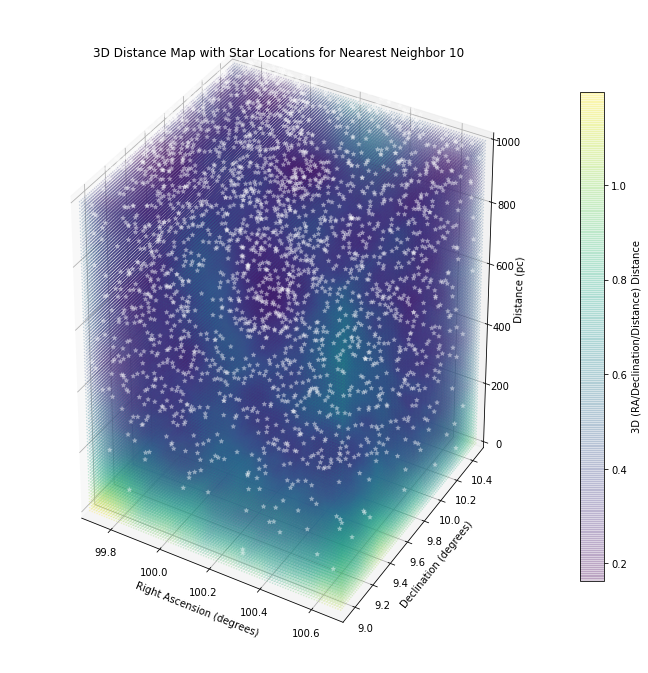

Elapsed Time: 141.31558990478516 seconds
Elapsed Time: 2.355259831746419 minutes


In [9]:
def DistanceMap3D(Distances3D):
    #Creates the three-dimensional kth nearest neighbor distance arrays needed and plots in 3D the distance map
    #Also creates three-dimensional plot of star locations for comparison and combines these plots
    #Parameter Distances3D is the sequence of three-dimensional kth nearest neighbor distances
    tic=time.time()
    #Gets starting time
    fig=plt.figure()
    ax=plt.axes(projection='3d')
    #Sets up a new figure and establishes the settings as three-dimensional
    x=numpy.linspace(RAMin,RAMax,N)
    y=numpy.linspace(DecMin,DecMax,N)
    z=numpy.linspace(DistanceMin,DistanceMax,N)
    #Making fresh array of linearly spaced points for each axis
    PlotPixelArray=numpy.zeros((NumberOfPoints,3))
    #Creates list with 3 columns to be used for plotting later
    i=0
    for RA in x:
        for Dec in y:
            for Distance in z:
                PlotPixelArray[i,0]=RA
                PlotPixelArray[i,1]=Dec
                PlotPixelArray[i,2]=Distance
                i+=1
    X=PlotPixelArray[:,0]
    Y=PlotPixelArray[:,1]
    Z=PlotPixelArray[:,2]
    #Uses a loop to cycle through all grid points and makes X, Y, and Z vectors to plot
    Pixels=numpy.zeros([N,N,N])
    #Makes 3D grid array of zeros
    for RA in range(0,N):
        for Dec in range(0,N):
            for Distance in range(0,N):
                Pixels[RA,Dec,Distance]=Distances3D[RA+Dec+Distance]
    #Sets as each element in the 3D grid array the kth nearest neighbor distance
    plt.rcParams['figure.figsize']=12,12
    plt.rcParams['axes.facecolor']='white'
    #Sets the figure size and background color
    Distances3D=numpy.ndarray.flatten(Distances3D)
    #Flattens the distances array into a one-dimensional vector for use as a color mapping
    Map3D=ax.scatter3D(X,Y,Z,c=Distances3D,cmap='viridis',marker='o',s=0.5,depthshade=True,alpha=0.2)
    #Plots in 3D translucent vectors with the color map as the kth nearest neighor distance with opacity varying to show depth
    plt.title('3D Distance Map for Nearest Neighbor %g'%(k))
    ax.set_xlabel('Right Ascension (degrees)')
    ax.set_xlim([RAMin,RAMax])
    ax.set_ylabel('Declination (degrees)')
    ax.set_ylim([DecMin,DecMax])
    ax.set_zlabel('Distance (pc)')
    ax.set_zlim([DistanceMin,DistanceMax])
    #Makes appropriate title, axis labels, and limits for variables
    cbar=fig.colorbar(Map3D,shrink=0.75)
    cbar.set_label('3D (RA/Declination/Distance) Distance',rotation='90')
    #Adds a color bar for the 3D distance, labels it, and rotates the label
    plt.show()
    fig=plt.figure()
    ax=plt.axes(projection='3d')
    #Creates another new figure and reestablishes 3D axis settings
    plt.rcParams['figure.figsize']=12,12
    plt.rcParams['axes.facecolor']='white'
    ax.scatter3D(X,Y,Z,c=Distances3D,cmap='viridis',marker='o',s=0.5,depthshade=True,alpha=0.2)
    #Plots in 3D translucent vectors with the color map as the kth nearest neighor distance with opacity varying to show depth
    cbar=fig.colorbar(Map3D,shrink=0.75)
    cbar.set_label('3D (RA/Declination/Distance) Distance',rotation='90')
    #Adds a color bar for the 3D distance, labels it, and rotates the label
    ax.scatter3D(StarRA,StarDec,StarDistance,c='xkcd:white',marker='*',s=20,depthshade=True)
    #Plots the three-dimensional position of all stars as white stars with opacity varying to show depth
    plt.title('3D Distance Map with Star Locations for Nearest Neighbor %g'%(k))
    ax.set_xlabel('Right Ascension (degrees)')
    ax.set_xlim([RAMin,RAMax])
    ax.set_ylabel('Declination (degrees)')
    ax.set_ylim([DecMin,DecMax])
    ax.set_zlabel('Distance (pc)')
    ax.set_zlim([DistanceMin,DistanceMax])
    #Makes appropriate title, axis labels, and limits for variables
    plt.show()
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (PlotPixelArray,X,Y,Z,Pixels)
plt.rcParams['axes.facecolor']='white'
plt.rcParams['figure.figsize']=12,12
PlotPixelArray,X,Y,Z,Pixels=DistanceMap3D(Distances3D)

In [10]:
def CloudCalculations():
    #Runs the calculations to set up cloud plots in three-dimensional space
    tic=time.time()
    #Gets the starting time
    Distance3DMed=numpy.median(Distances3D)
    Distance3DAvg=numpy.average(Distances3D)
    #Computes the median and average of the kth nearest neighbor three-dimensional distance
    Cloudx=numpy.array([])
    Cloudy=numpy.array([])
    Cloudz=numpy.array([])
    #Makes empty arrays for the next step
    for i in range(0,len(Distances3D)):
        if Distances3D[i]>=Distance3DMed and Z[i]>=200:
            Cloudx=numpy.append(Cloudx,X[i])
            Cloudy=numpy.append(Cloudy,Y[i])
            Cloudz=numpy.append(Cloudz,Z[i])
    #Adds to the RA, declination, and distance arrays if the kth nearest neighbor distance is equal to or greater than the
    #median 3D distance and the distance is equal or greater than 200 pc (assumes there is negligible extinction or clouds
    #within 200 pc)
    toc=time.time()
    #Gets the final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz)
Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz=CloudCalculations()

Elapsed Time: 494.9472858905792 seconds
Elapsed Time: 8.249121431509653 minutes


30 degrees above xy-plane; 0 degrees rotated from standard view


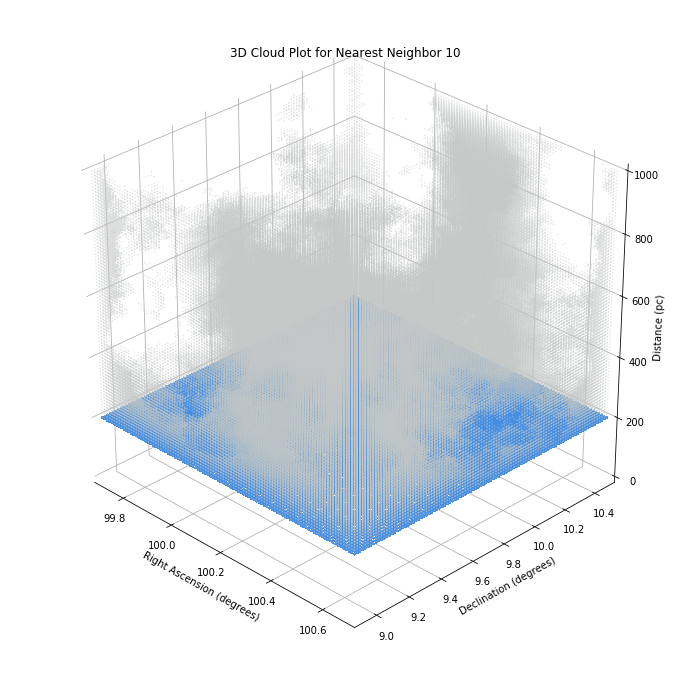

60 degrees above xy-plane; 0 degrees rotated from standard view


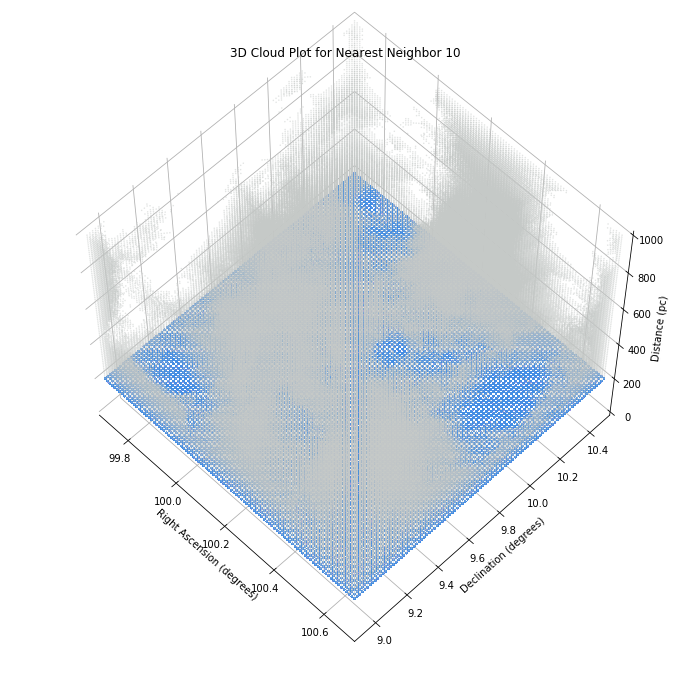

90 degrees above xy-plane; 0 degrees rotated from standard view


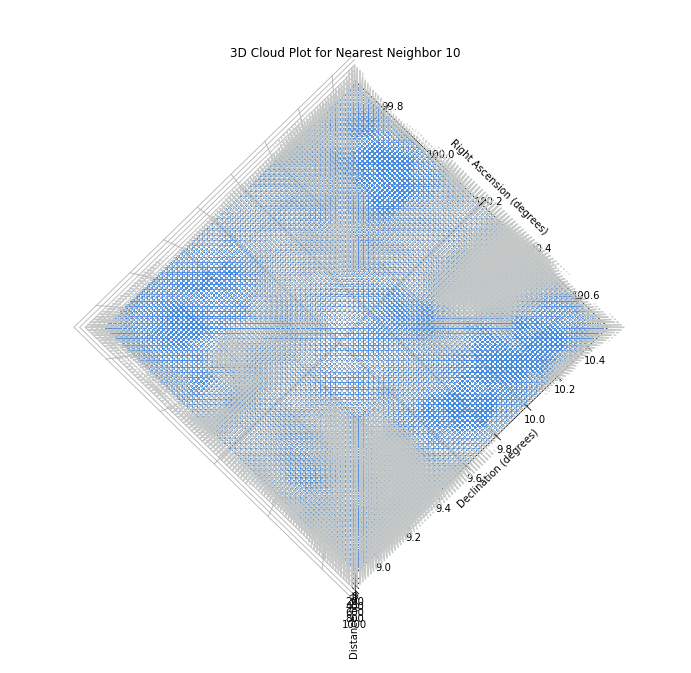

-30 degrees above xy-plane; 0 degrees rotated from standard view


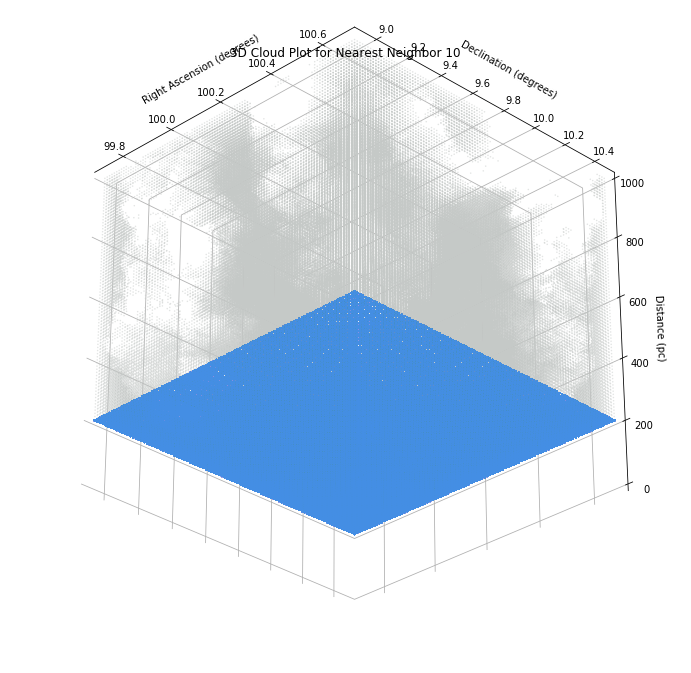

-60 degrees above xy-plane; 0 degrees rotated from standard view


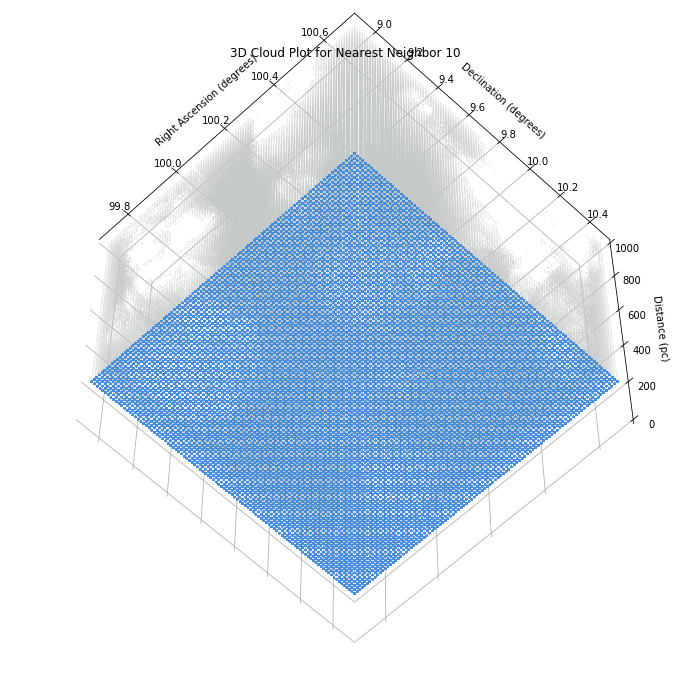

30 degrees above xy-plane; 90 degrees rotated from standard view


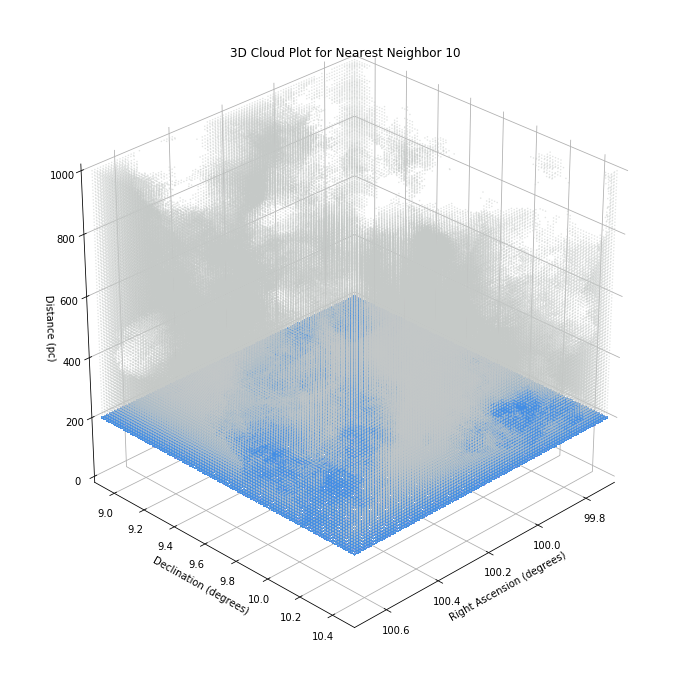

60 degrees above xy-plane; 90 degrees rotated from standard view


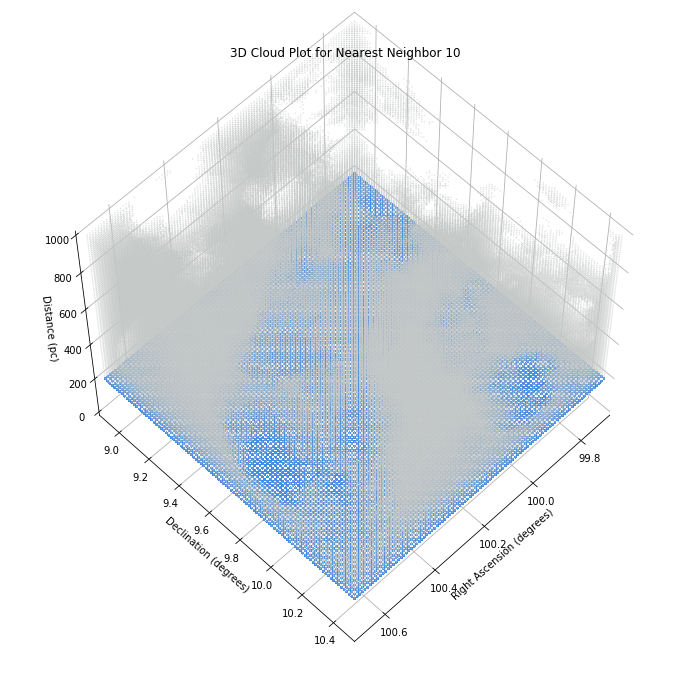

90 degrees above xy-plane; 90 degrees rotated from standard view


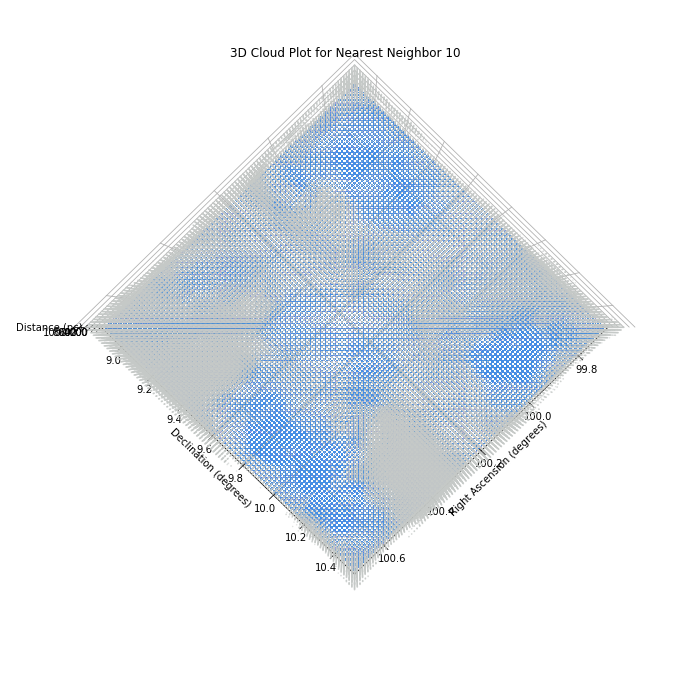

-30 degrees above xy-plane; 90 degrees rotated from standard view


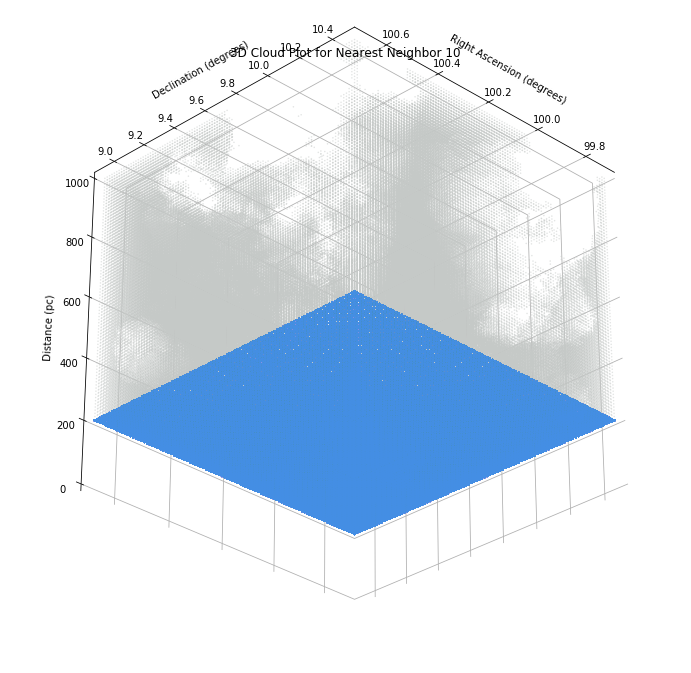

-60 degrees above xy-plane; 90 degrees rotated from standard view


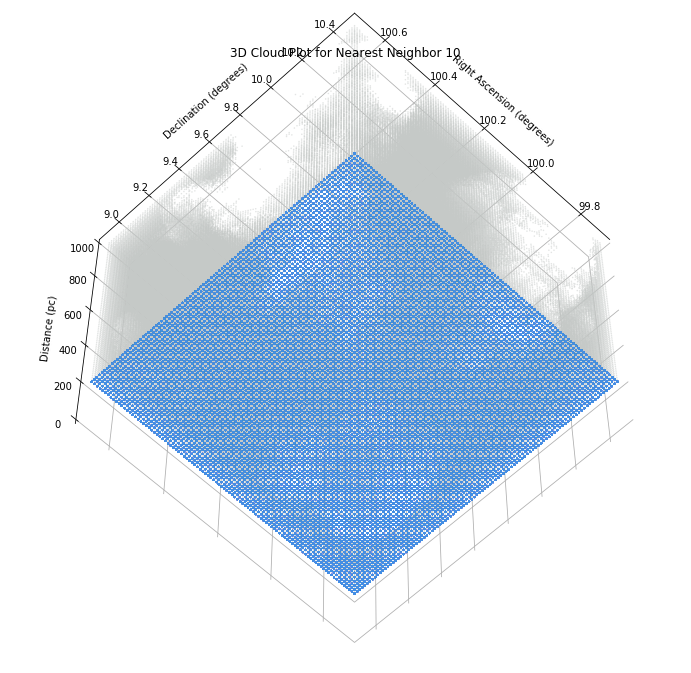

30 degrees above xy-plane; 180 degrees rotated from standard view


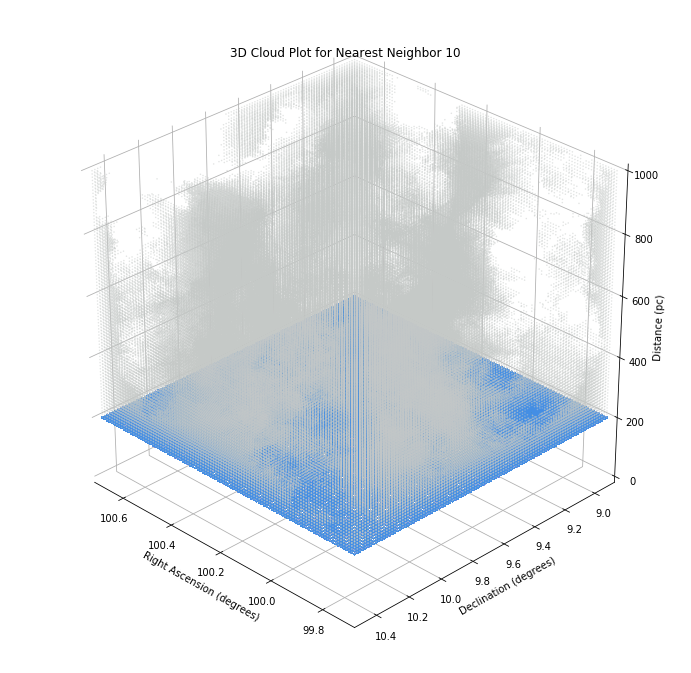

60 degrees above xy-plane; 180 degrees rotated from standard view


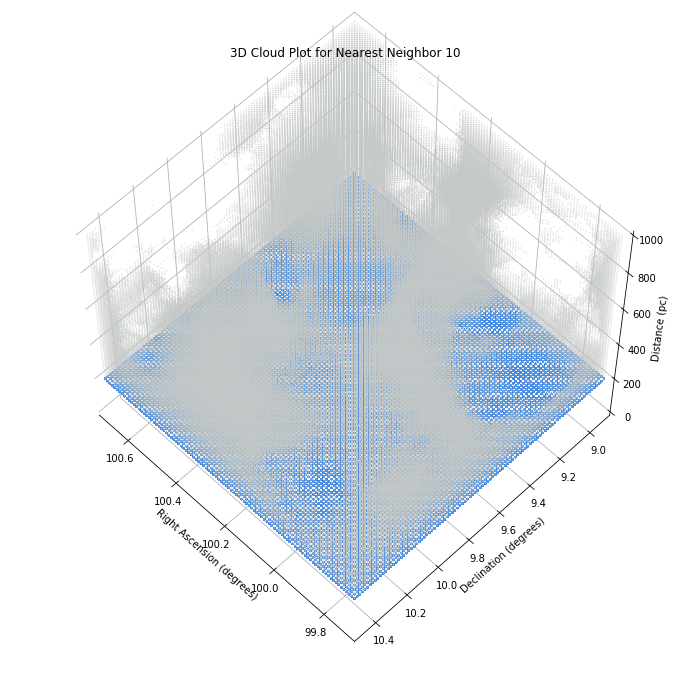

90 degrees above xy-plane; 180 degrees rotated from standard view


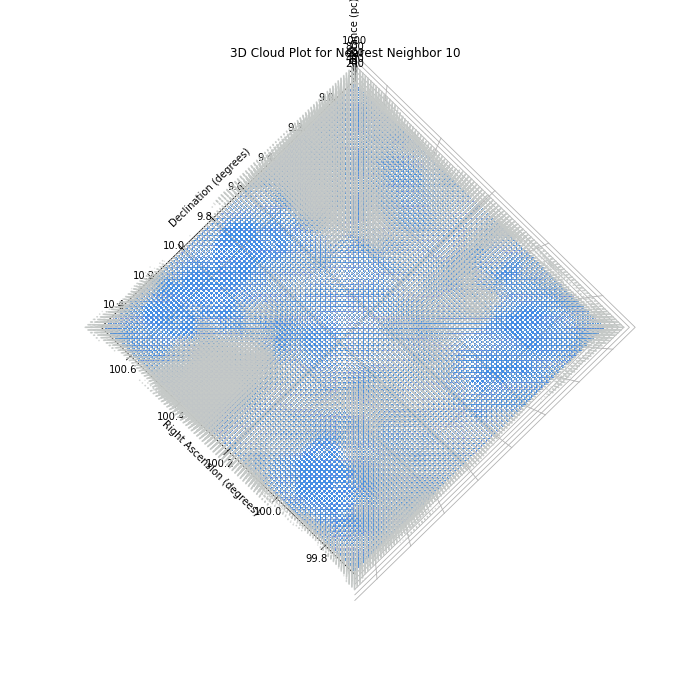

-30 degrees above xy-plane; 180 degrees rotated from standard view


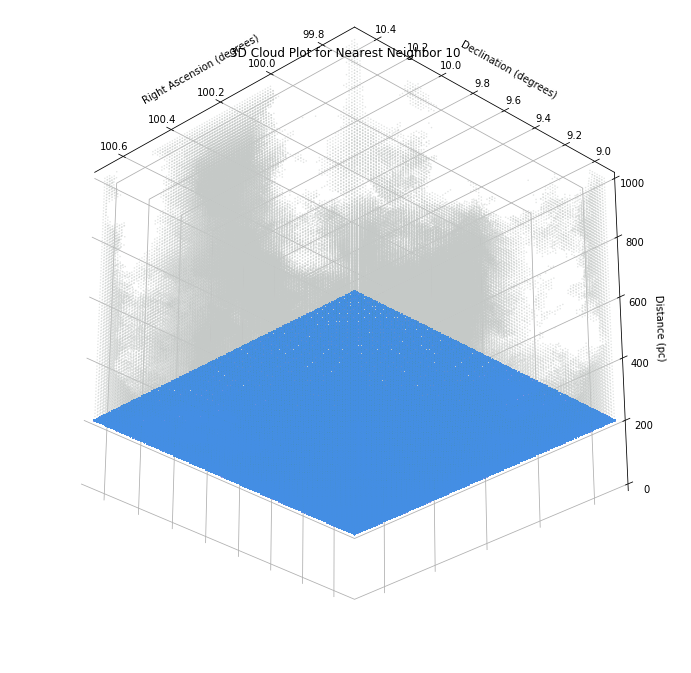

-60 degrees above xy-plane; 180 degrees rotated from standard view


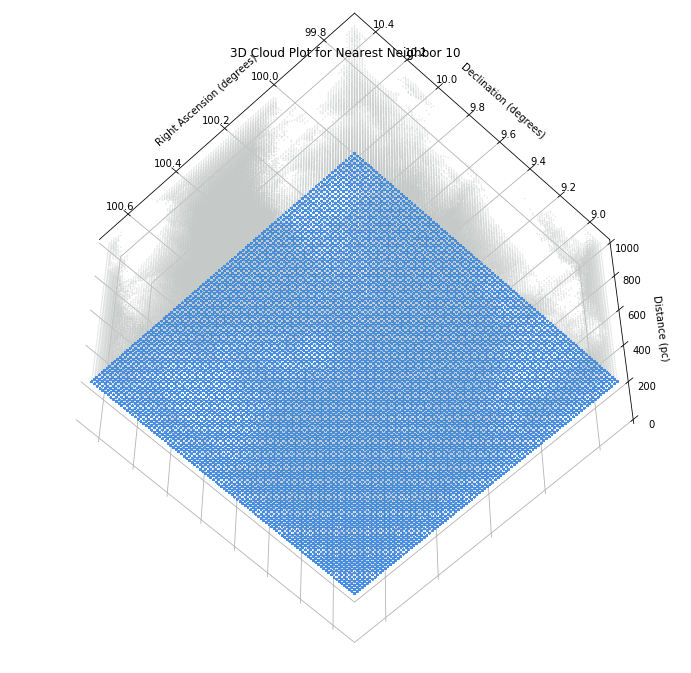

30 degrees above xy-plane; 270 degrees rotated from standard view


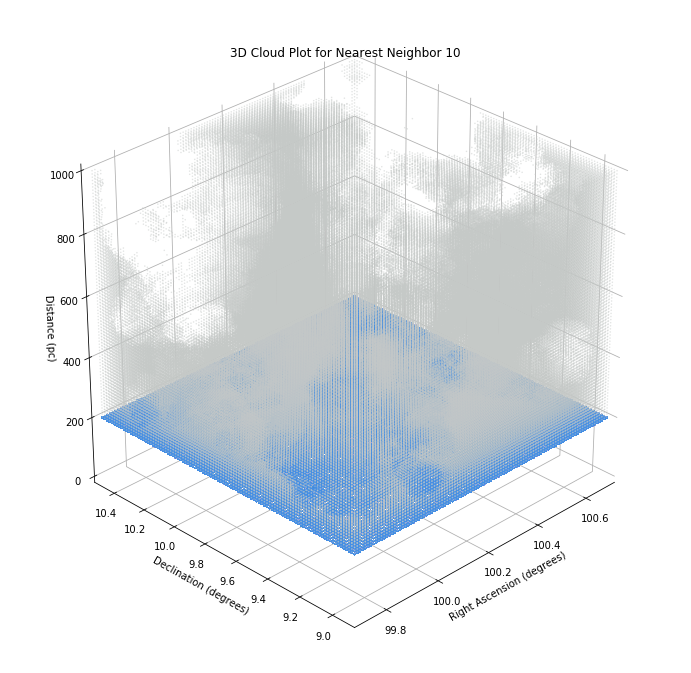

60 degrees above xy-plane; 270 degrees rotated from standard view


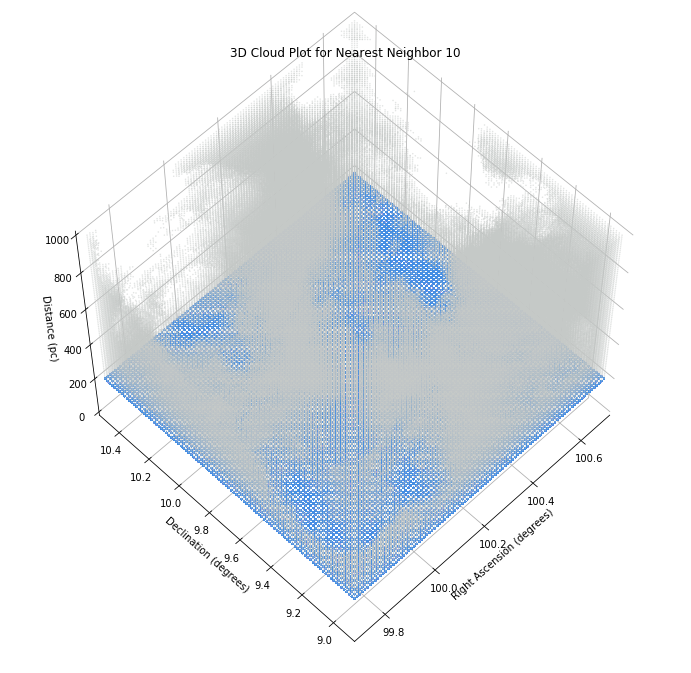

90 degrees above xy-plane; 270 degrees rotated from standard view


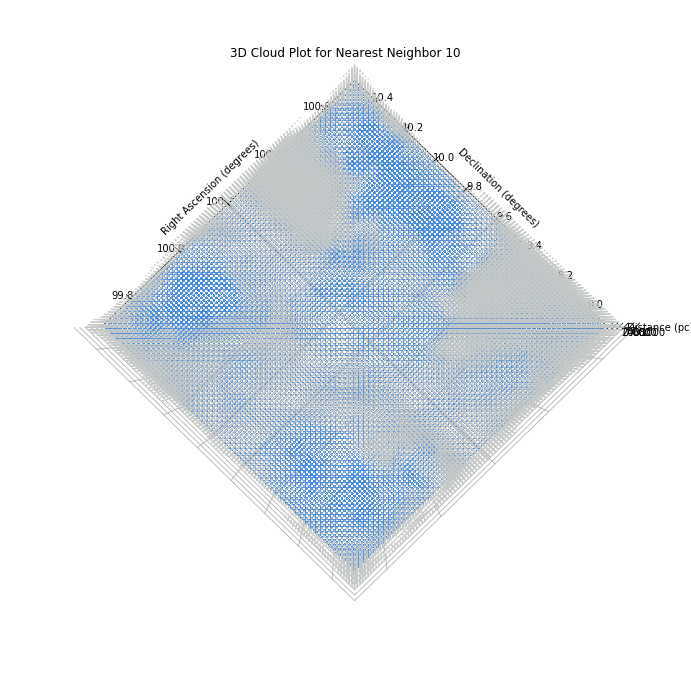

-30 degrees above xy-plane; 270 degrees rotated from standard view


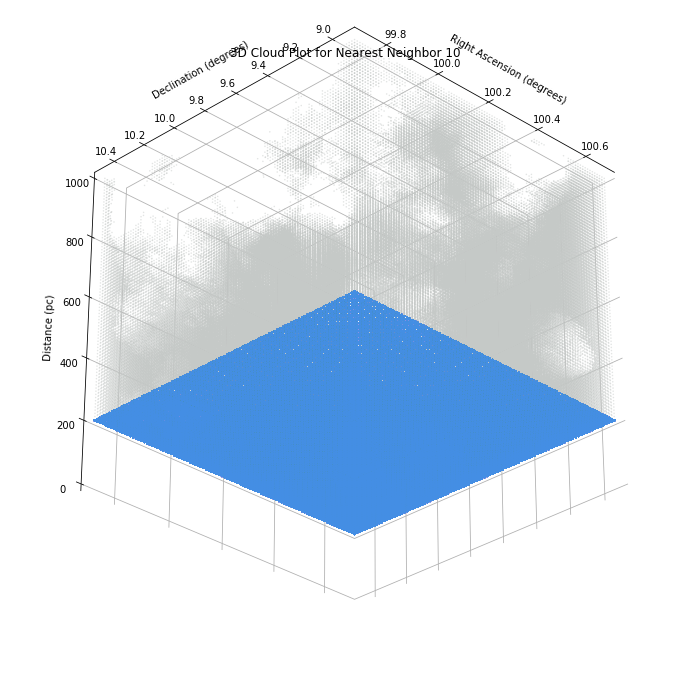

-60 degrees above xy-plane; 270 degrees rotated from standard view


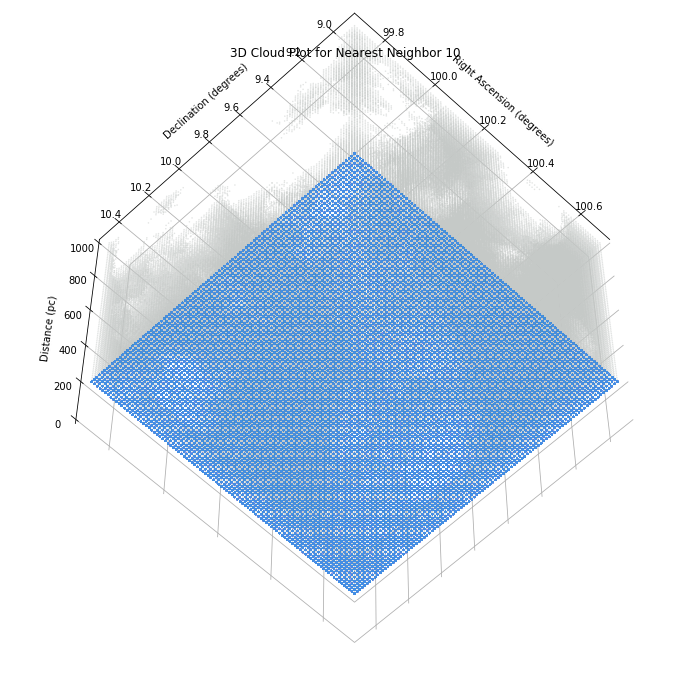

Elapsed Time: 1667.1888065338135 seconds
Elapsed Time: 27.786480108896892 minutes


In [11]:
def CloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector):
    #Plots the three-dimensional "surface" and interior of supposed clouds for the given region of the sky
    #Parameter BackgroundColor is the plot's plane colors (theme) and must be a string; currently supported entries are 'black'
    #and 'white'
    #Parameter ElevationAngleVector is a vector containing the different elevation angles above xy-plane desired to be shown
    #Parameter AzimuthalAngleVector is a vector containing the different azimuthal angles (rotating around z-axis) desired to be
    #shown
    tic=time.time()
    #Gets the starting time
    plt.rcParams['axes.facecolor']='white'
    #Sets figure background color
    if BackgroundColor=='black':
        for i in range(0,len(AzimuthalAngleVector)):
            for j in range(0,len(ElevationAngleVector)):
                print(ElevationAngleVector[j],'degrees above xy-plane;',AzimuthalAngleVector[i]+45,'degrees rotated from standard view')
                fig=plt.figure()
                ax=plt.axes(projection='3d')
                #Sets up a figure and establishes the settings as three-dimensional
                ax.w_xaxis.set_pane_color((0,0,0,1))
                ax.w_yaxis.set_pane_color((0,0,0,1))
                ax.w_zaxis.set_pane_color((0,0,0,1))
                #Makes the graph color (theme) black
                ax.scatter3D(X,Y,200,color='xkcd:dark sky blue',marker='o',s=1,depthshade=True,alpha=1)
                #Makes a plane at a distance of 200 pc from Earth to partition off clouds from region of no assumed extinction
                ax.scatter3D(Cloudx,Cloudy,Cloudz,color='xkcd:grey',marker='o',s=0.25,depthshade=True,alpha=0.5)
                #Makes scatter plot in grey to show the structure of the clouds ("surface" and interior)
                ax.view_init(ElevationAngleVector[j],AzimuthalAngleVector[i])
                #Sets the perspective to go through all of the combinations of the specified elevation and azimuthal angles
                plt.title('3D Cloud Plot for Nearest Neighbor %g'%(k))
                ax.set_xlabel('Right Ascension (degrees)')
                ax.set_xlim([RAMin,RAMax])
                ax.set_ylabel('Declination (degrees)')
                ax.set_ylim([DecMin,DecMax])
                ax.set_zlabel('Distance (pc)')
                ax.set_zlim([DistanceMin,DistanceMax])
                #Makes appropriate title, axis labels, and limits for variables
                plt.show()
    if BackgroundColor=='white':
        for i in range(0,len(AzimuthalAngleVector)):
            for j in range(0,len(ElevationAngleVector)):
                print(ElevationAngleVector[j],'degrees above xy-plane;',AzimuthalAngleVector[i]+45,'degrees rotated from standard view')
                fig=plt.figure()
                ax=plt.axes(projection='3d')
                #Sets up a figure and establishes the settings as three-dimensional
                ax.w_xaxis.set_pane_color((1,1,1,1))
                ax.w_yaxis.set_pane_color((1,1,1,1))
                ax.w_zaxis.set_pane_color((1,1,1,1))
                #Makes the graph color (theme) white
                ax.scatter3D(X,Y,200,color='xkcd:dark sky blue',marker='o',s=1,depthshade=True,alpha=1)
                #Makes a plane at a distance of 200 pc from Earth to partition off clouds from region of no assumed extinction
                ax.scatter3D(Cloudx,Cloudy,Cloudz,color='xkcd:silver',marker='o',s=0.25,depthshade=True,alpha=0.5)
                #Makes scatter plot in silver to show the structure of the clouds ("surface" and interior)
                ax.view_init(ElevationAngleVector[j],AzimuthalAngleVector[i])
                #Sets the perspective to go through all of the combinations of the specified elevation and azimuthal angles
                plt.title('3D Cloud Plot for Nearest Neighbor %g'%(k))
                ax.set_xlabel('Right Ascension (degrees)')
                ax.set_xlim([RAMin,RAMax])
                ax.set_ylabel('Declination (degrees)')
                ax.set_ylim([DecMin,DecMax])
                ax.set_zlabel('Distance (pc)')
                ax.set_zlim([DistanceMin,DistanceMax])
                #Makes appropriate title, axis labels, and limits for variables
                plt.show()
    #Takes the color input parameter and changes the plot settings accordingly
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
ElevationAngleVector=[30,60,90,-30,-60]
AzimuthalAngleVector=[-45,45,135,225]
BackgroundColor='white'
CloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector)
#Runs the function with a white background

In [12]:
def Contour3D(n,q,ColorVector,theta,phi):
    #Manually creates "contours" in three dimensions with the chosen color mapping being the kth nearest neighbor distance
    #Parameter n is the number of contour levels desired
    #Parameter q is the number of the n contour levels that should be shown in the plot
    #Parameter ColorVector is the vector of strings of color names; this cannot be an RGB or RGBA tuple, only strings work
    #Parameter theta is the desired elevation angle above the xy-plane for the plot
    #Parameter phi is the desired azimuthal angle (around z-axis) rotated from +45 degrees from the standard view
    tic=time.time()
    #Gets the starting time
    fig=plt.figure()
    ax=fig.add_subplot(111,projection='3d')
    #Creates a figure and makes the settings three-dimensional for plotting
    plt.rcParams['figure.figsize']=12,12
    plt.rcParams['axes.facecolor']='white'
    #Sets the figure size and background color
    Distance3DMin=min(Distances3D)
    Distance3DMax=max(Distances3D)
    #Computes the minimum and maximum of the kth nearest neighbor distances in 3D
    ContourLevels=numpy.linspace(Distance3DMin,Distance3DMax,n)
    #Makes a linearly spaced vector between the minimum and maximum kth nearest neighbor distances with n contour levels
    for i in range(0,q-1):
        Contourx=numpy.array([])
        Contoury=numpy.array([])
        Contourz=numpy.array([])
        #Creates empty arrays for use in the next step
        for j in range(0,len(Distances3D)):
            if Distances3D[j]>=ContourLevels[i] and Distances3D[j]<=ContourLevels[i+1]:
                Contourx=numpy.append(Contourx,X[j])
                Contoury=numpy.append(Contoury,Y[j])
                Contourz=numpy.append(Contourz,Z[j])
        #Appends to the contour coordinate arrays if the pixel's kth nearest neighbor distance lies between the two contours
        ax.scatter3D(Contourx,Contoury,Contourz,c=ColorVector[i],marker='o',s=0.5,depthshade=True,alpha=0.2)
        #Plots translucent points with the color map as the kth nearest neighor distance with opacity varying to show depth
    ax.view_init(theta,phi)
    #Sets the perspective for the desired elevation and azimuthal angles
    plt.title('3D Contour Plot for Nearest Neighbor %g and %g out of %g Contours Shown'%(k,q,n))
    ax.set_xlabel('Right Ascension (degrees)')
    ax.set_xlim([RAMin,RAMax])
    ax.set_ylabel('Declination (degrees)')
    ax.set_ylim([DecMin,DecMax])
    ax.set_zlabel('Distance (pc)')
    ax.set_zlim([DistanceMin,DistanceMax])
    #Makes appropriate title, axis labels, and limits for variables
    plt.show()
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (Distance3DMin,Distance3DMax,ContourLevels)

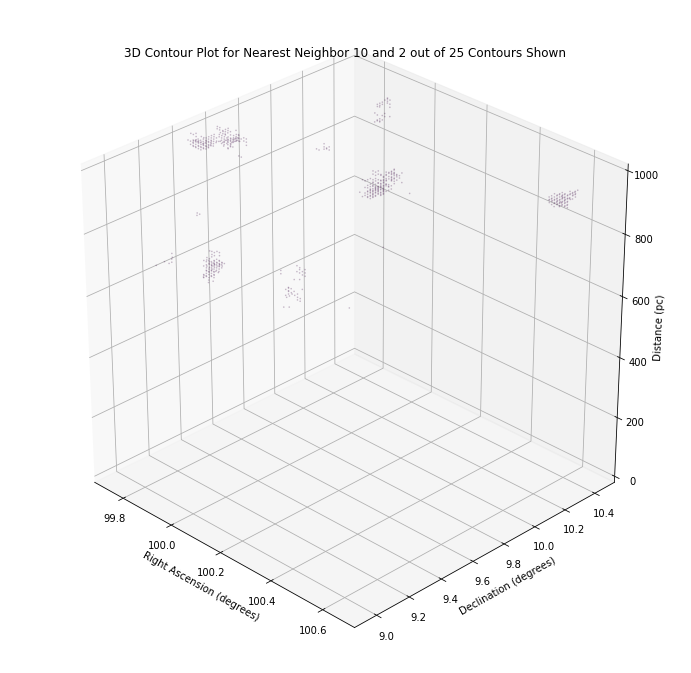

Elapsed Time: 4.49962306022644 seconds
Elapsed Time: 0.07499371767044068 minutes


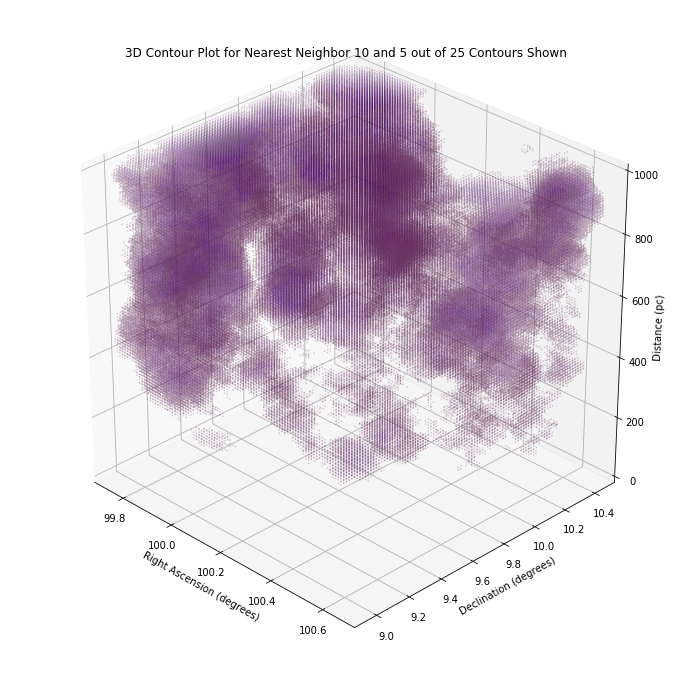

Elapsed Time: 78.16555976867676 seconds
Elapsed Time: 1.302759329477946 minutes


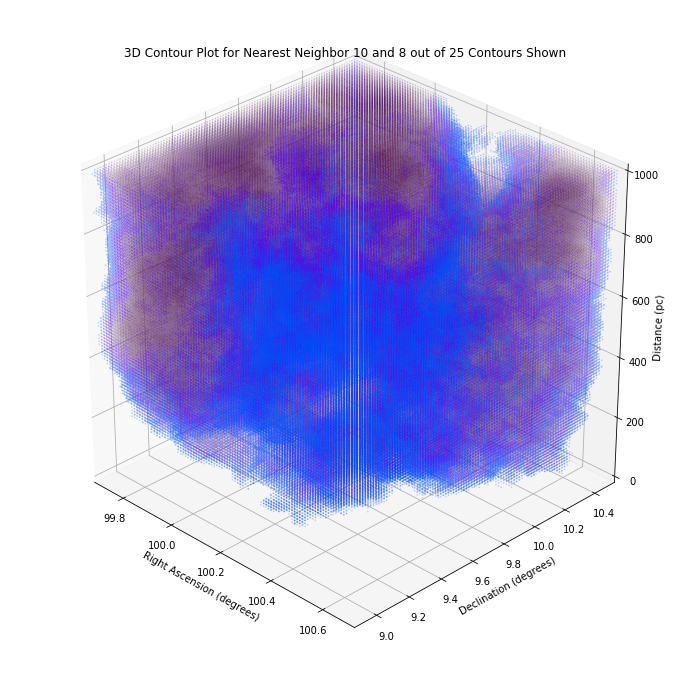

Elapsed Time: 428.35125637054443 seconds
Elapsed Time: 7.13918760617574 minutes


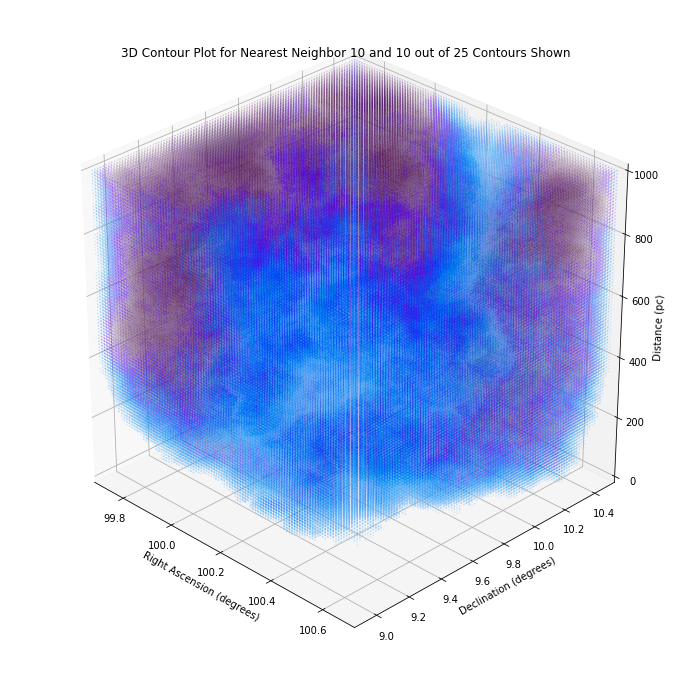

Elapsed Time: 417.0962698459625 seconds
Elapsed Time: 6.951604497432709 minutes


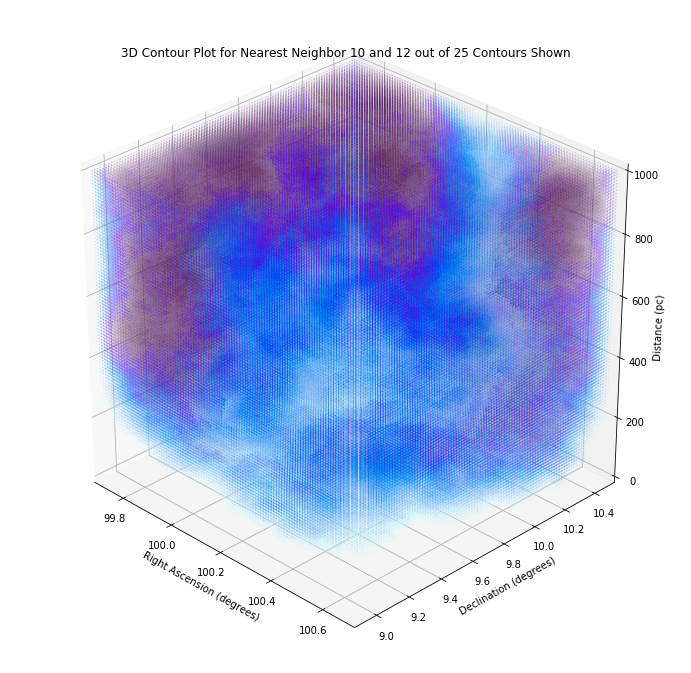

Elapsed Time: 419.7064037322998 seconds
Elapsed Time: 6.995106728871663 minutes


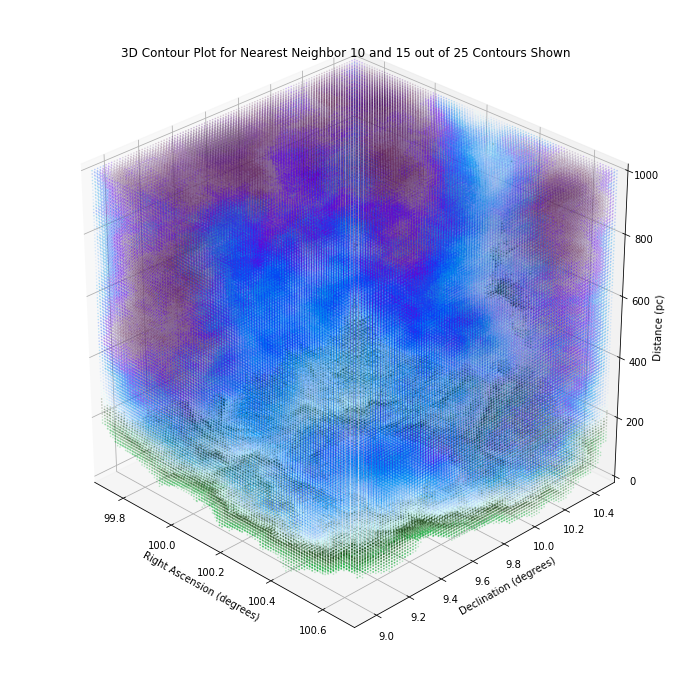

Elapsed Time: 436.3283803462982 seconds
Elapsed Time: 7.272139672438303 minutes


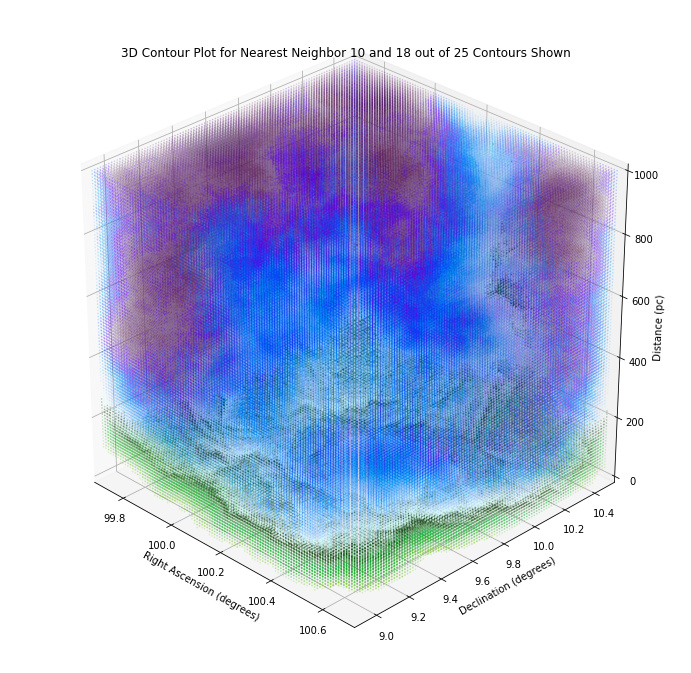

Elapsed Time: 444.40766882896423 seconds
Elapsed Time: 7.406794480482737 minutes


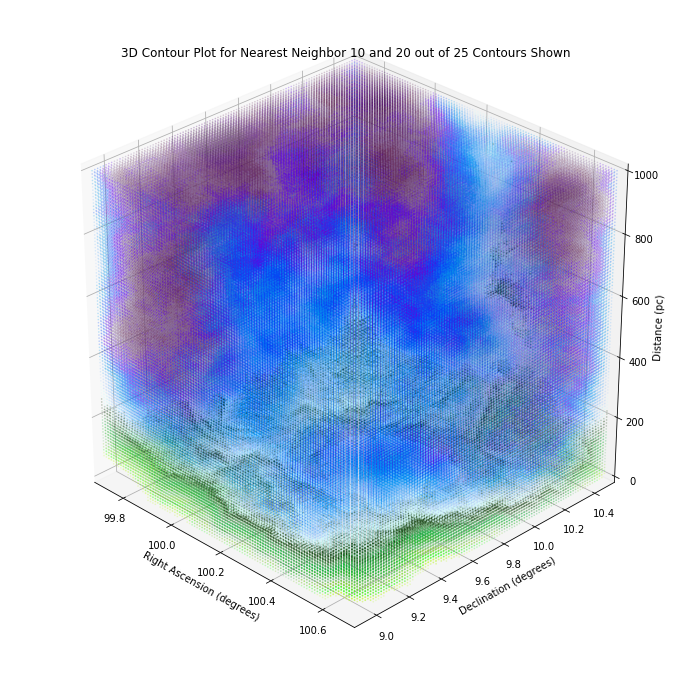

Elapsed Time: 501.3648421764374 seconds
Elapsed Time: 8.356080702940623 minutes


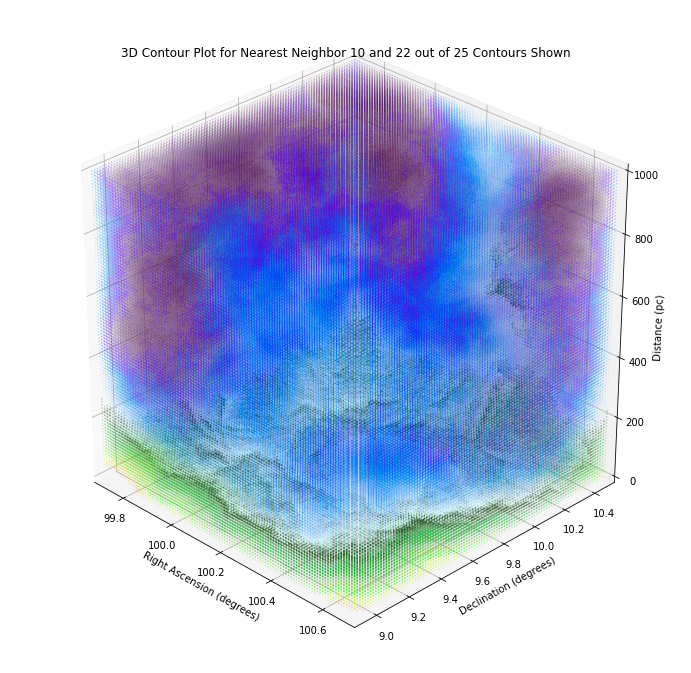

Elapsed Time: 450.8436064720154 seconds
Elapsed Time: 7.514060107866923 minutes


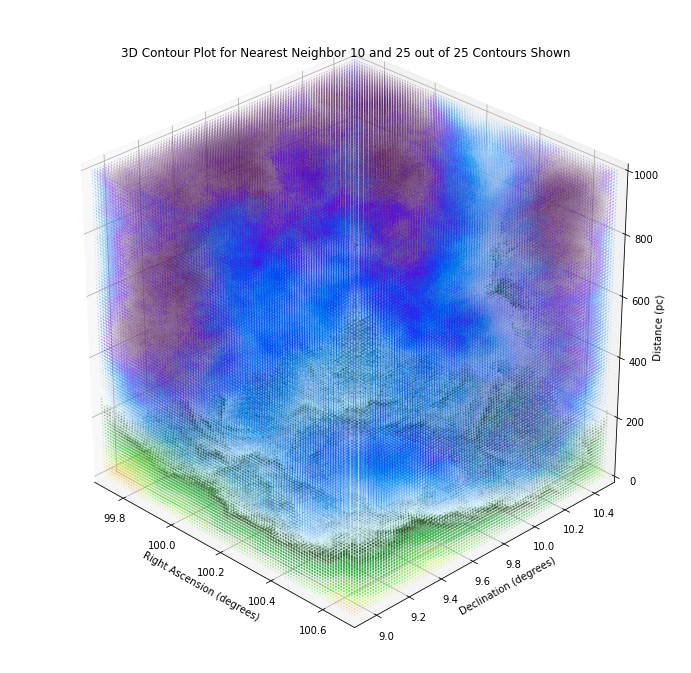

Elapsed Time: 477.08436608314514 seconds
Elapsed Time: 7.951406101385753 minutes


In [13]:
xkcdColorsViridisAnalog=['xkcd:deep purple','xkcd:dark purple','xkcd:royal purple','xkcd:grape','xkcd:dark lavender','xkcd:blue violet','xkcd:electric blue','xkcd:azure','xkcd:sky blue','xkcd:powder blue','xkcd:pale blue','xkcd:dark green','xkcd:light forest green','xkcd:kelly green','xkcd:green','xkcd:soft green','xkcd:apple green','xkcd:electric green','xkcd:yellow green','xkcd:chartreuse','xkcd:light orange','xkcd:gold','xkcd:golden yellow','xkcd:yellowish','xkcd:yellow']
ColorVector=xkcdColorsViridisAnalog
n=25
q=2
theta=30
phi=-45
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=5
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=8
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=10
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=12
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=15
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=18
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=20
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=22
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=25
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)

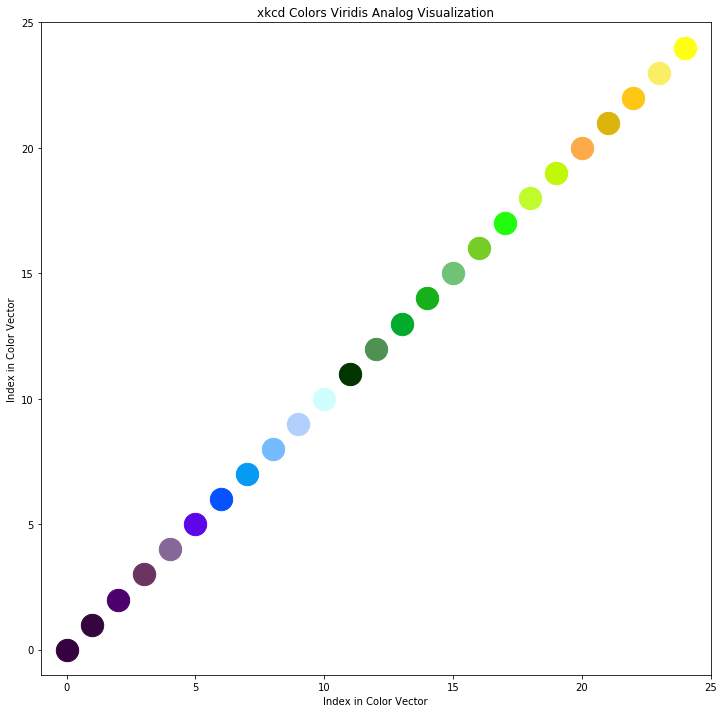

In [14]:
fig=plt.figure()
plt.rcParams['axes.facecolor']='white'
plt.rcParams['figure.figsize']=12,12
#Makes figure and sets background color and figure size
for i in range(0,len(xkcdColorsViridisAnalog)):
    plt.scatter(i,i,c=xkcdColorsViridisAnalog[i],s=500,marker='o',alpha=1)
#Plots as points along y=x the sequence of colors in the xkcd colors viridis analog color map to see them
plt.title('xkcd Colors Viridis Analog Visualization')
plt.xlabel('Index in Color Vector')
plt.ylabel('Index in Color Vector')
plt.xlim([-1,len(xkcdColorsViridisAnalog)])
plt.ylim([-1,len(xkcdColorsViridisAnalog)])
#Sets appropriate title, axis limits, and axis labels
plt.show()

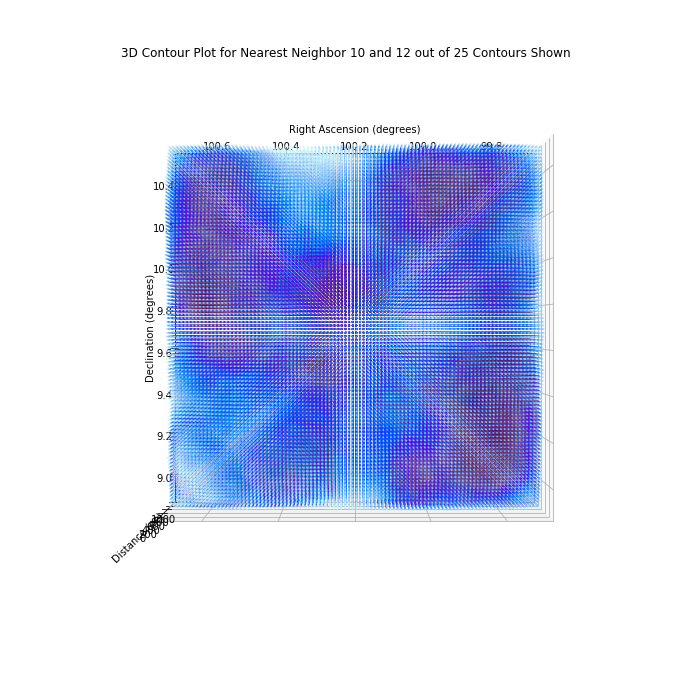

Elapsed Time: 507.2059826850891 seconds
Elapsed Time: 8.453433044751485 minutes


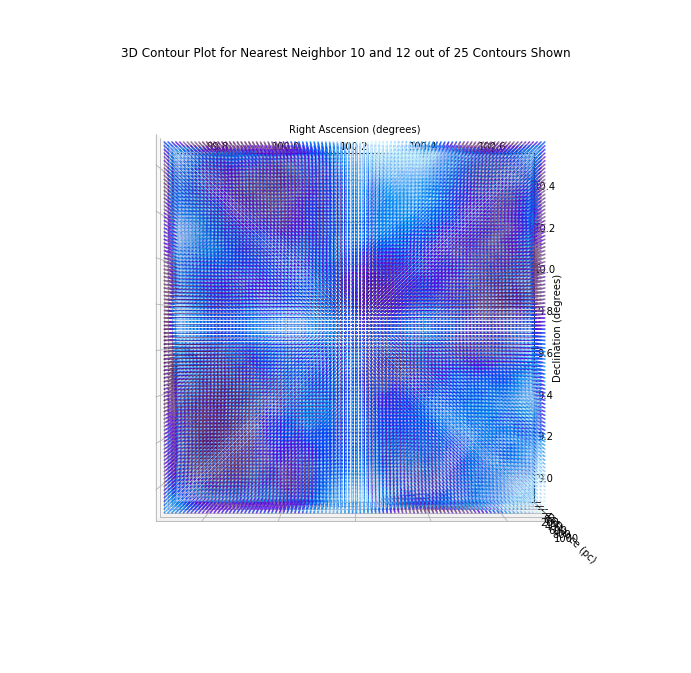

Elapsed Time: 449.92536759376526 seconds
Elapsed Time: 7.498756126562754 minutes


In [15]:
theta=-90
phi=90
n=25
q=12
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
theta=90
phi=-90
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)

In [44]:
StarRA,StarDec,Gmag,Parallax,ParallaxError=Assignments(t)
StarDistance,DistanceAverage,DistanceStDev,Distance=SpectralDistances(M)
def distance(x,y):
    #
    #Parameter x
    #Parameter y
    return numpy.sqrt((y[0]-x[0])**2+(y[1]-x[1])**2+((y[2]-x[2])/2000)**2)
for i in range(0,len(StarDistance)):
    dist1=distance([StarRA[i],StarDec[i],StarDistance[i]],[99.9,9.2,200])
    dist2=distance([StarRA[i],StarDec[i],StarDistance[i]],[100.4,10.1,800])
    if dist1<=0.4 or dist2<=0.4:
        StarDistance[i]=10000
SpectralDistanceSpecial=numpy.array([])
for i in range(0,len(StarDistance)):
    if StarDistance[i]<=1000:
        SpectralDistanceSpecial=numpy.append(SpectralDistanceSpecial,StarDistance[i])
DistanceAverage=numpy.average(SpectralDistanceSpecial)
DistanceStDev=numpy.std(SpectralDistanceSpecial)
Distance=SpectralDistanceSpecial-DistanceAverage
Distance=Distance/DistanceStDev
StarRASpecial=numpy.array([])
StarDecSpecial=numpy.array([])
for i in range(0,len(StarDistance)):
    if StarDistance[i]<=1000:
        StarRASpecial=numpy.append(StarRASpecial,StarRA[i])
        StarDecSpecial=numpy.append(StarDecSpecial,StarDec[i])
StarRA=StarRASpecial
StarDec=StarDecSpecial

The columns within this catalog are: 
['_Glon', '_Glat', '_RAJ2000', '_DEJ2000', 'RA_ICRS', 'e_RA_ICRS', 'DE_ICRS', 'e_DE_ICRS', 'Source', 'Epoch', 'Plx', 'e_Plx', 'pmRA', 'e_pmRA', 'pmDE', 'e_pmDE', 'Dup', '__Gmag_', 'GLON', 'GLAT']


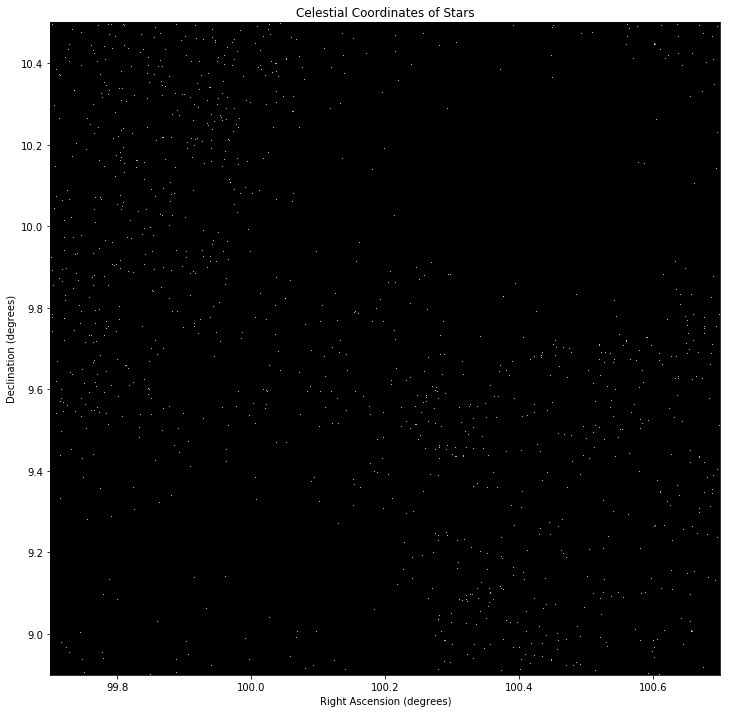

Done
Elapsed Time: 0.12033271789550781 seconds
Elapsed Time: 0.0020055452982584636 minutes


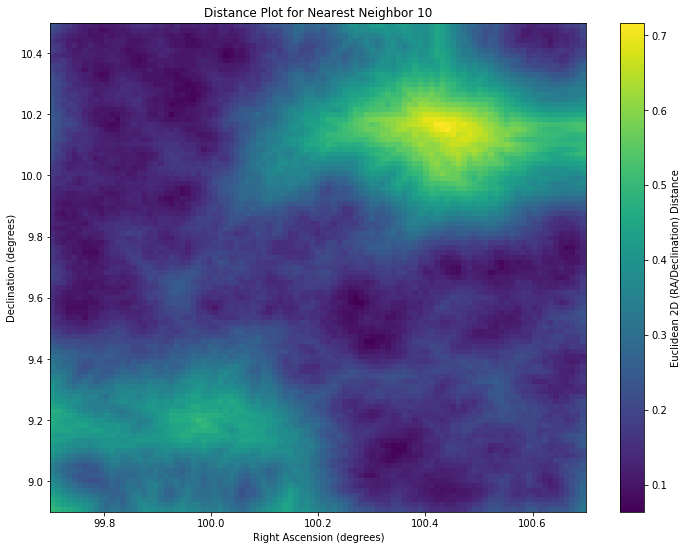

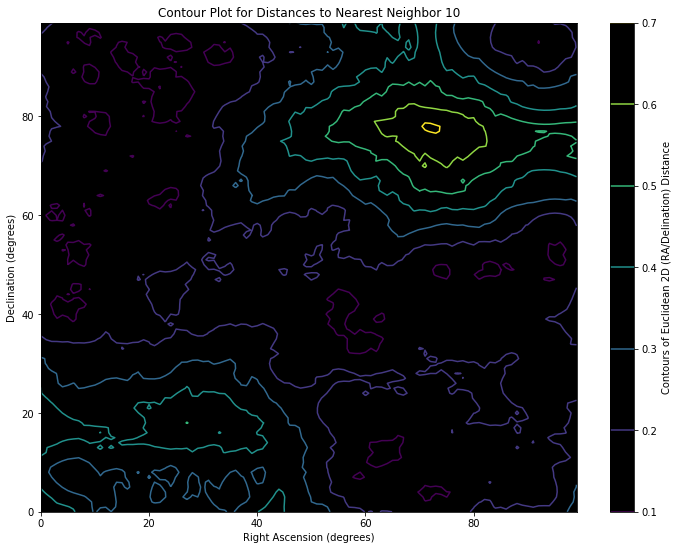

In [45]:
plt.rcParams['axes.facecolor']='black'
SkyRegionPlot(StarRA,StarDec,RAMin,RAMax,DecMin,DecMax)
RAStDev,DecStDev,RAAverage,DecAverage,RA,Dec,RAPixels,DecPixels,Pixels2D=PixelSetup(StarRA,StarDec,N)
plt.rcParams['axes.facecolor']='white'
distance,indices=NearestNeighbor2D(k)
Distances=DistanceMap2D()
plt.rcParams['axes.facecolor']='black'
n=10
DistanceMapContour2D(n)

Done
Elapsed Time: 3.000600576400757 seconds
Elapsed Time: 0.05001000960667928 minutes


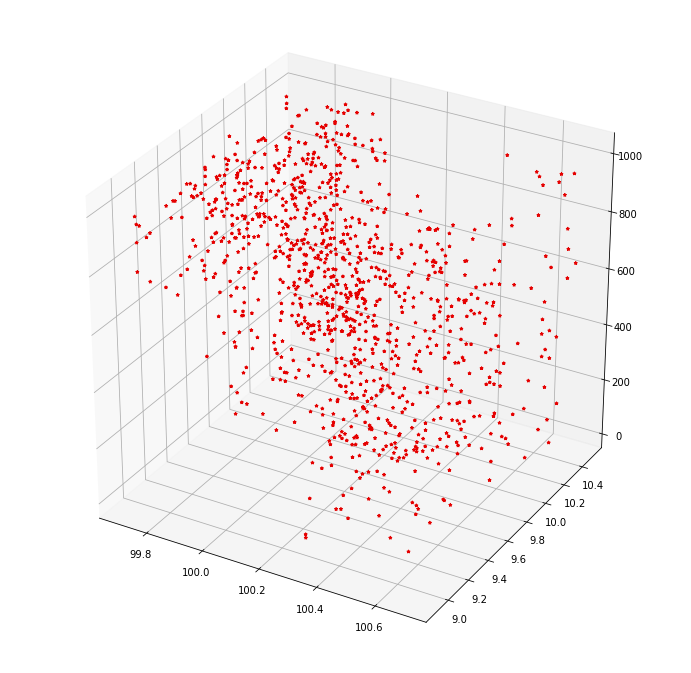

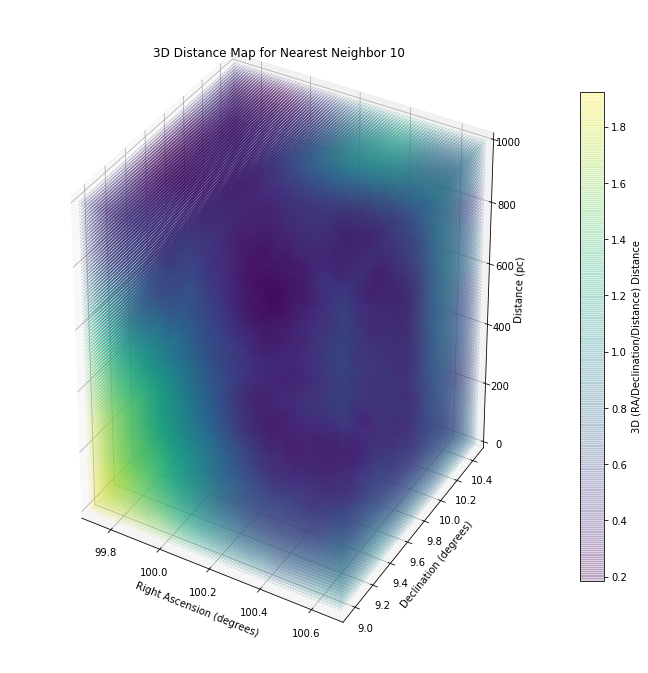

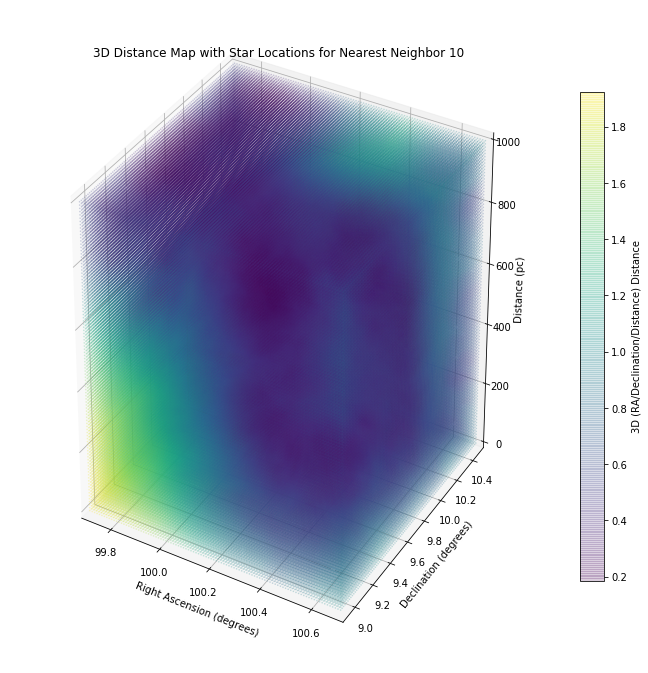

Elapsed Time: 140.8738079071045 seconds
Elapsed Time: 2.3478967984517416 minutes


'Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz=CloudCalculations()\nCloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector)'

In [46]:
StarDistance=SpectralDistanceSpecial
DistancePixels,StarArray,NumberOfPoints,Distances3D,Indices3D=NearestNeighbor3D(k,DistanceMin,DistanceMax,RA,Dec,Distance)
plt.rcParams['figure.figsize']=12,12
plt.rcParams['axes.facecolor']='white'
fig=plt.figure()
ax=plt.axes(projection='3d')
ax.scatter3D(StarRASpecial,StarDecSpecial,SpectralDistanceSpecial,c='xkcd:red',marker='*',s=10,depthshade=True,alpha=1)
PlotPixelArray,X,Y,Z,Pixels=DistanceMap3D(Distances3D)
'''Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz=CloudCalculations()
CloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector)'''

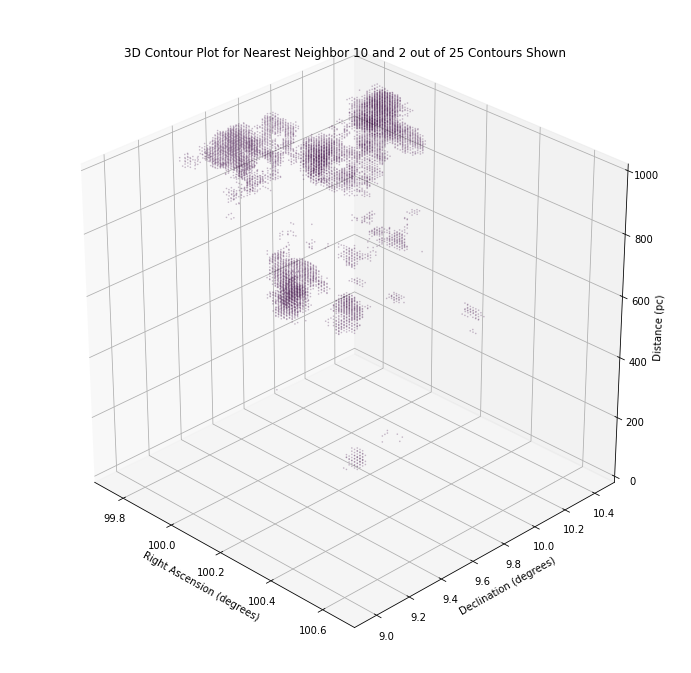

Elapsed Time: 6.217079401016235 seconds
Elapsed Time: 0.10361799001693725 minutes


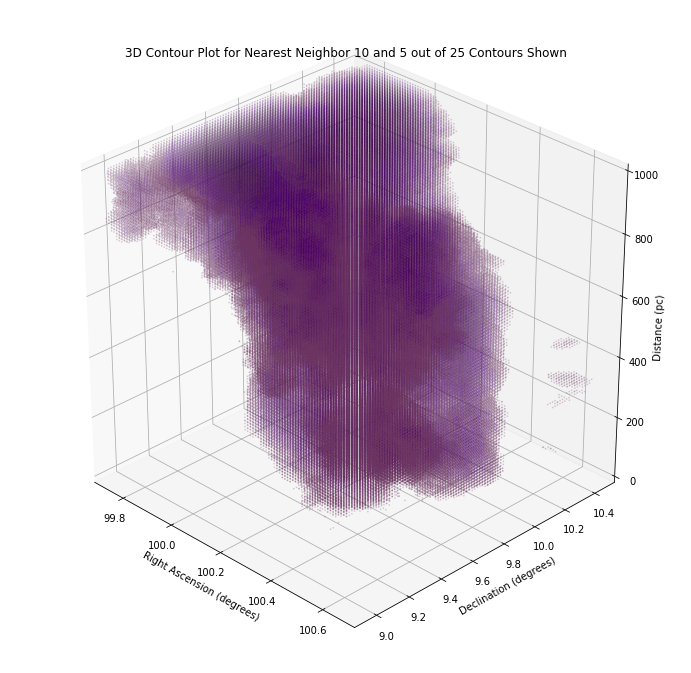

Elapsed Time: 233.90079474449158 seconds
Elapsed Time: 3.8983465790748597 minutes


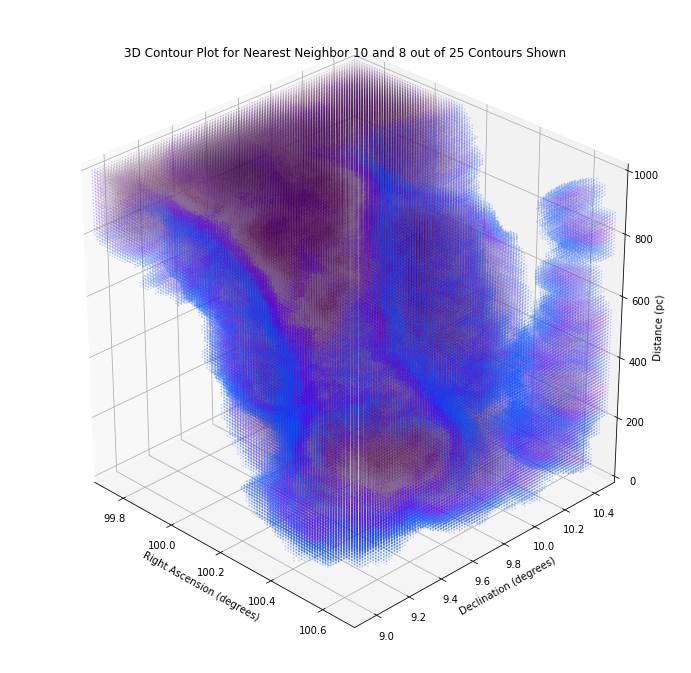

Elapsed Time: 302.5860221385956 seconds
Elapsed Time: 5.043100368976593 minutes


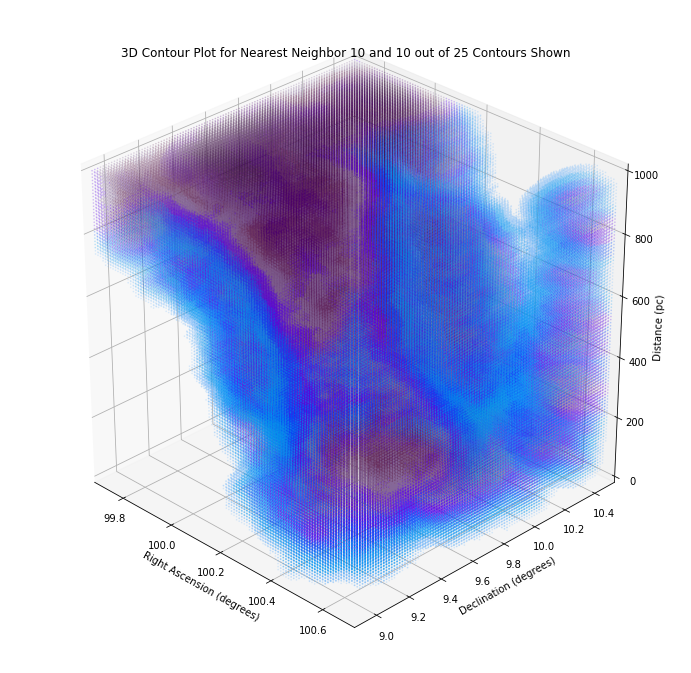

Elapsed Time: 291.87977504730225 seconds
Elapsed Time: 4.864662917455037 minutes


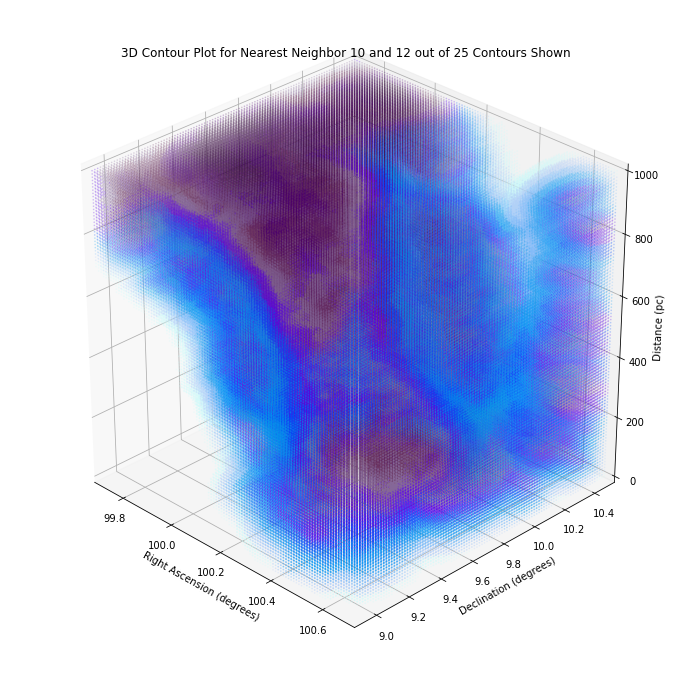

Elapsed Time: 303.2989704608917 seconds
Elapsed Time: 5.054982841014862 minutes


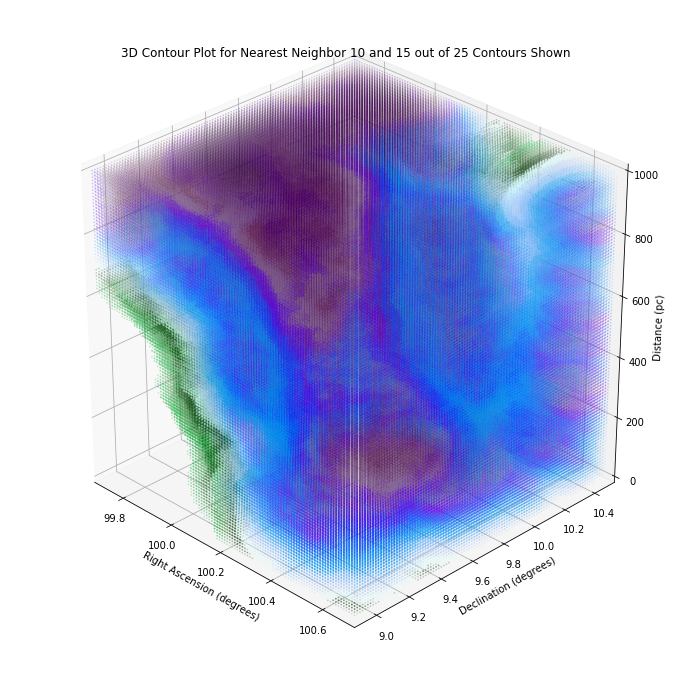

Elapsed Time: 316.64953112602234 seconds
Elapsed Time: 5.277492185433705 minutes


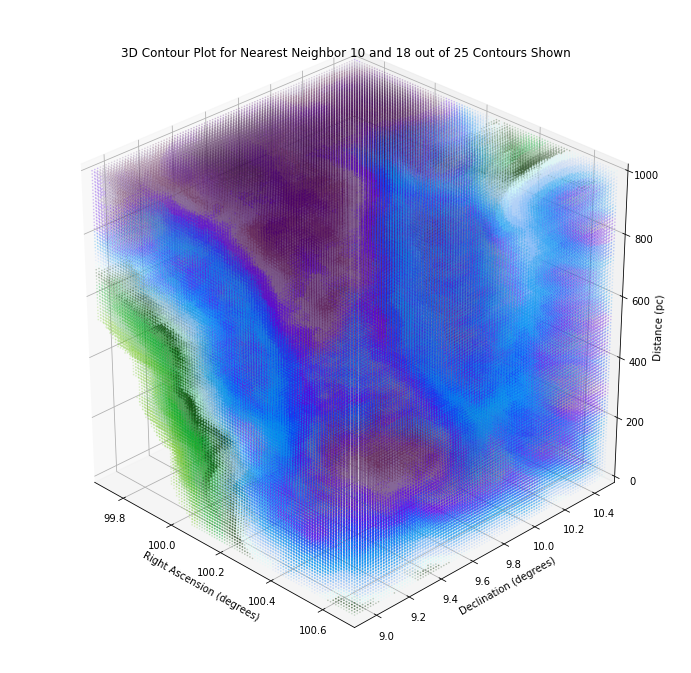

Elapsed Time: 306.2216544151306 seconds
Elapsed Time: 5.103694240252177 minutes


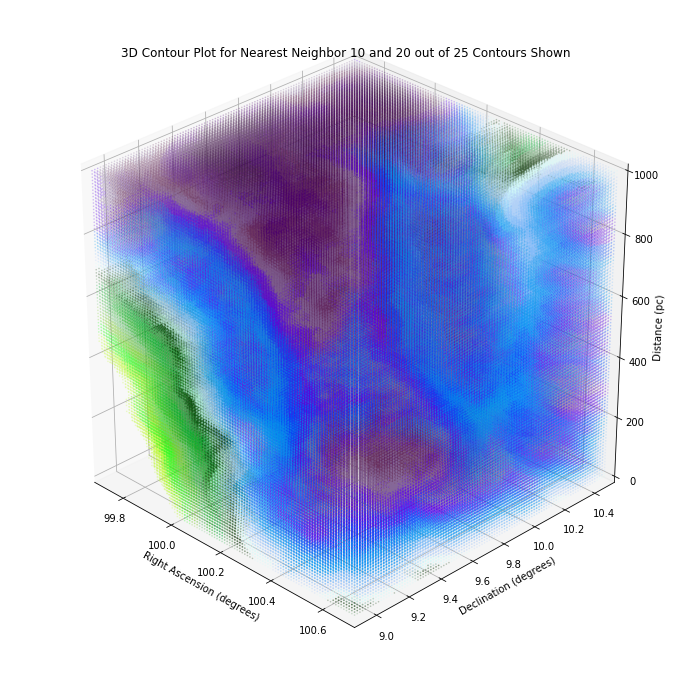

Elapsed Time: 312.98091220855713 seconds
Elapsed Time: 5.216348536809286 minutes


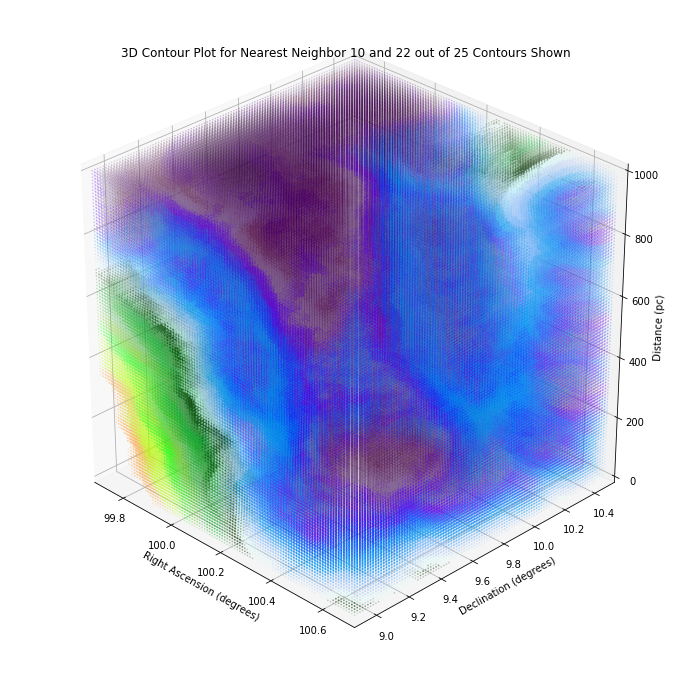

Elapsed Time: 318.19638872146606 seconds
Elapsed Time: 5.3032731453577675 minutes


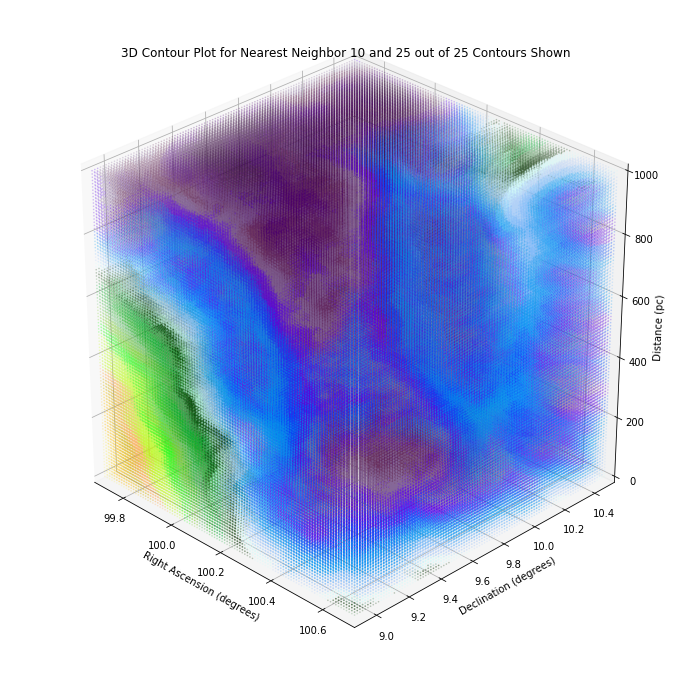

Elapsed Time: 332.4835810661316 seconds
Elapsed Time: 5.5413930177688595 minutes


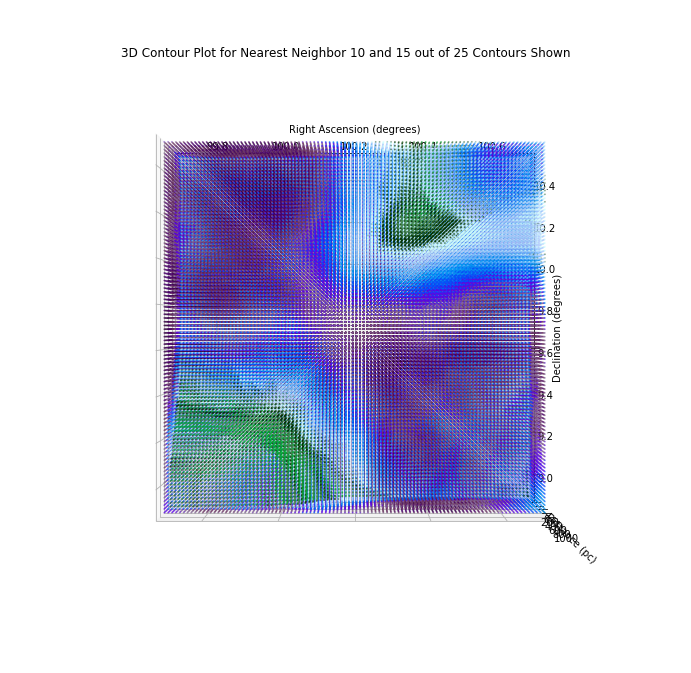

Elapsed Time: 302.8350291252136 seconds
Elapsed Time: 5.047250485420227 minutes


In [47]:
plt.rcParams['axes.facecolor']='white'
xkcdColorsViridisAnalog=['xkcd:deep purple','xkcd:dark purple','xkcd:royal purple','xkcd:grape','xkcd:dark lavender','xkcd:blue violet','xkcd:electric blue','xkcd:azure','xkcd:sky blue','xkcd:powder blue','xkcd:pale blue','xkcd:dark green','xkcd:light forest green','xkcd:kelly green','xkcd:green','xkcd:soft green','xkcd:apple green','xkcd:electric green','xkcd:yellow green','xkcd:chartreuse','xkcd:light orange','xkcd:gold','xkcd:golden yellow','xkcd:yellowish','xkcd:yellow']
ColorVector=xkcdColorsViridisAnalog
n=25
q=2
theta=30
phi=-45
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=5
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=8
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=10
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=12
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=15
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=18
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=20
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=22
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=25
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
theta=90
phi=-90
q=15
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)

In [48]:
StarRA,StarDec,Gmag,Parallax,ParallaxError=Assignments(t)
StarDistance,DistanceAverage,DistanceStDev,Distance=SpectralDistances(M)

The columns within this catalog are: 
['_Glon', '_Glat', '_RAJ2000', '_DEJ2000', 'RA_ICRS', 'e_RA_ICRS', 'DE_ICRS', 'e_DE_ICRS', 'Source', 'Epoch', 'Plx', 'e_Plx', 'pmRA', 'e_pmRA', 'pmDE', 'e_pmDE', 'Dup', '__Gmag_', 'GLON', 'GLAT']


In [49]:
ParallaxRA=numpy.array([])
ParallaxDec=numpy.array([])
ParallaxDistance=numpy.array([])
ParallaxArcsec=(1/1000)*Parallax
Parallaxd=1/ParallaxArcsec
ParallaxCount=0
for i in range(0,len(StarRA)):
    if Parallax[i] is not numpy.ma.masked:
        ParallaxCount=ParallaxCount+1
        ParallaxRA=numpy.append(ParallaxRA,StarRA[i])
        ParallaxDec=numpy.append(ParallaxDec,StarDec[i])
        ParallaxDistance=numpy.append(ParallaxDistance,Parallaxd[i])
print('The number of stars in this data set which have parallaxes provided is:',ParallaxCount)
ParallaxDistanceSpecial=numpy.array([])
for i in range(0,len(ParallaxDistance)):
    if ParallaxDistance[i]<=1000:
        ParallaxDistanceSpecial=numpy.append(ParallaxDistanceSpecial,ParallaxDistance[i])
DistanceAverage=numpy.average(ParallaxDistanceSpecial)
DistanceStDev=numpy.std(ParallaxDistanceSpecial)
Distance=ParallaxDistance-DistanceAverage
Distance=Distance/DistanceStDev
StarRA=ParallaxRA
StarDec=ParallaxDec
StarDistance=ParallaxDistance

The number of stars in this data set which have parallaxes provided is: 84
Done
Elapsed Time: 2.1880500316619873 seconds
Elapsed Time: 0.03646750052769979 minutes


'Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz=CloudCalculations()\nCloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector)'

In [ ]:
plt.rcParams['axes.facecolor']='black'
SkyRegionPlot(StarRA,StarDec,RAMin,RAMax,DecMin,DecMax)
RAStDev,DecStDev,RAAverage,DecAverage,RA,Dec,RAPixels,DecPixels,Pixels2D=PixelSetup(StarRA,StarDec,N)
plt.rcParams['axes.facecolor']='white'
distance,indices=NearestNeighbor2D(k)
Distances=DistanceMap2D()
plt.rcParams['axes.facecolor']='black'
n=10
DistanceMapContour2D(n)

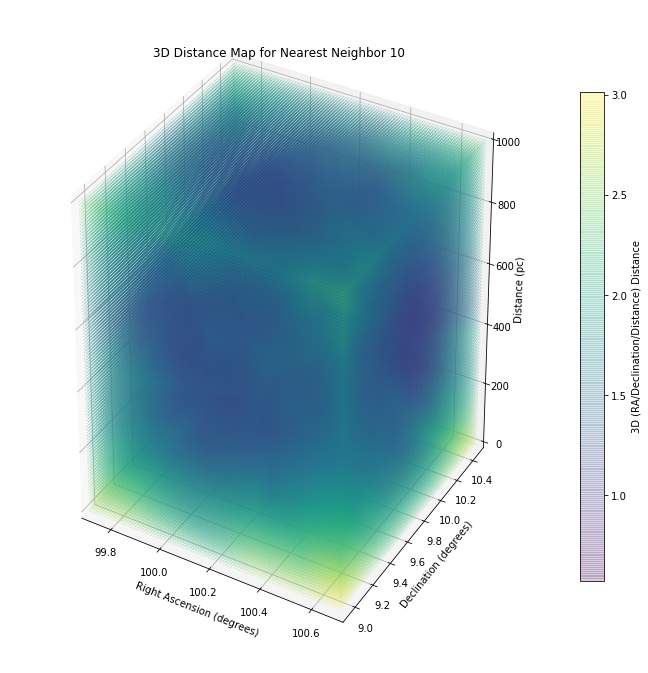

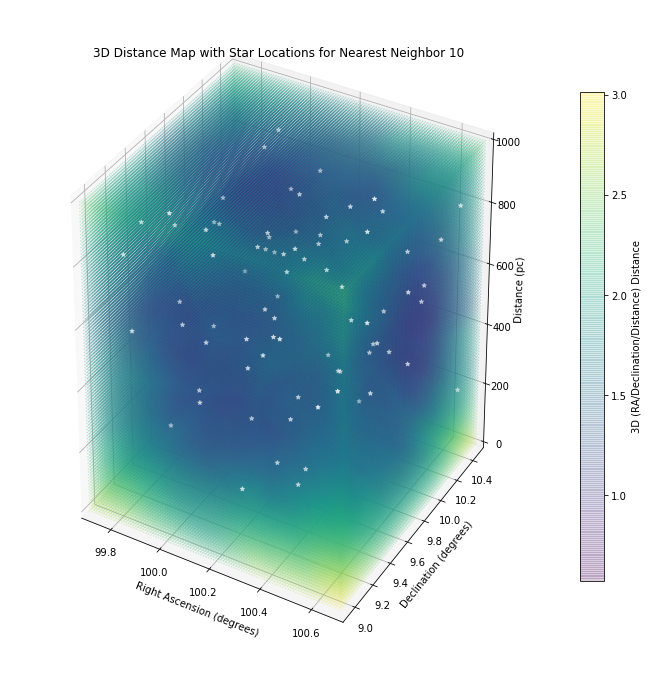

Elapsed Time: 137.18234872817993 seconds
Elapsed Time: 2.2863724788029987 minutes


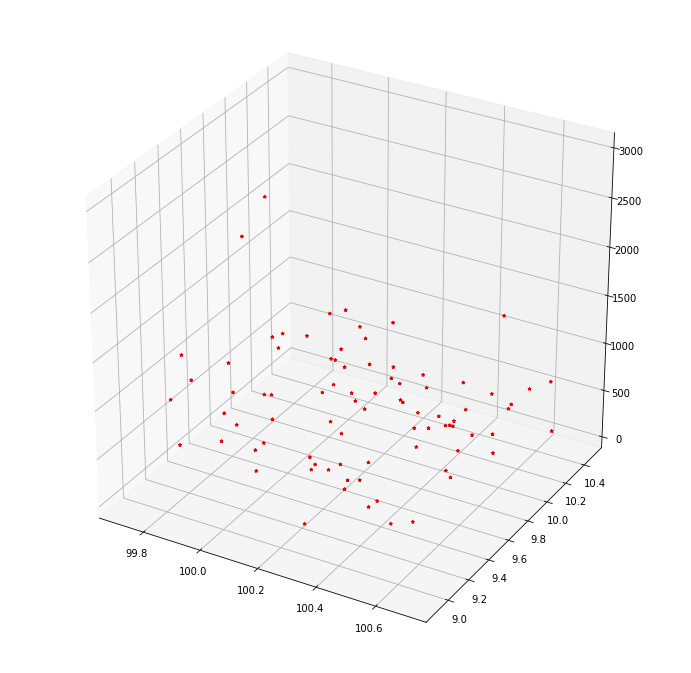

In [50]:
DistancePixels,StarArray,NumberOfPoints,Distances3D,Indices3D=NearestNeighbor3D(k,DistanceMin,DistanceMax,RA,Dec,Distance)
plt.rcParams['figure.figsize']=12,12
plt.rcParams['axes.facecolor']='white'
fig=plt.figure()
ax=plt.axes(projection='3d')
ax.scatter3D(StarRA,StarDec,StarDistance,c='xkcd:red',marker='*',s=10,depthshade=True,alpha=1)
PlotPixelArray,X,Y,Z,Pixels=DistanceMap3D(Distances3D)
'''Distance3DMed,Distance3DAvg,Cloudx,Cloudy,Cloudz=CloudCalculations()
CloudPlot(BackgroundColor,ElevationAngleVector,AzimuthalAngleVector)'''

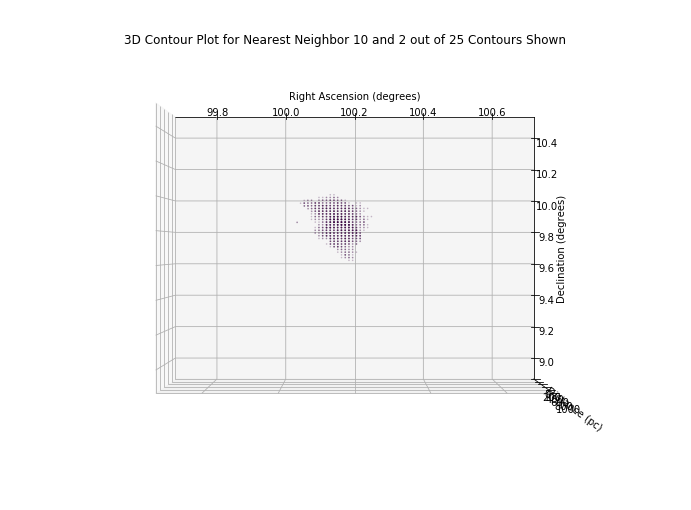

Elapsed Time: 4.83080267906189 seconds
Elapsed Time: 0.08051337798436482 minutes


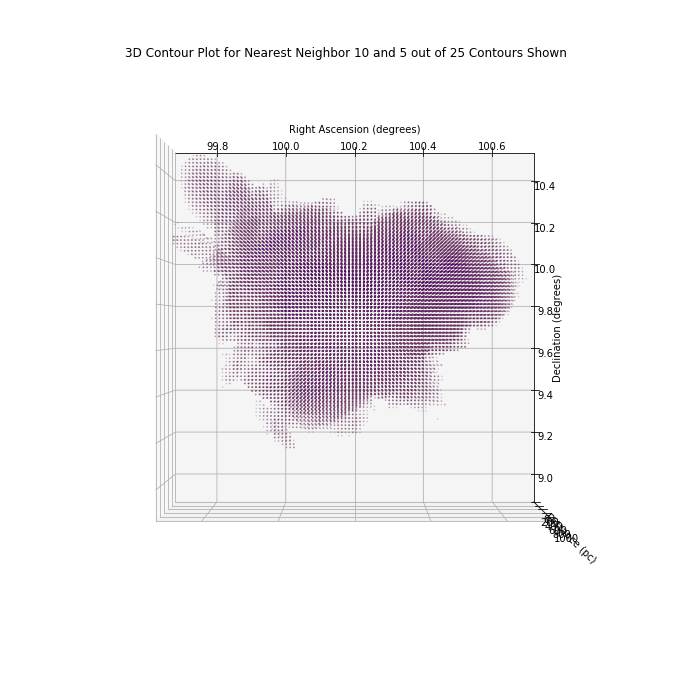

Elapsed Time: 25.03597116470337 seconds
Elapsed Time: 0.4172661860783895 minutes


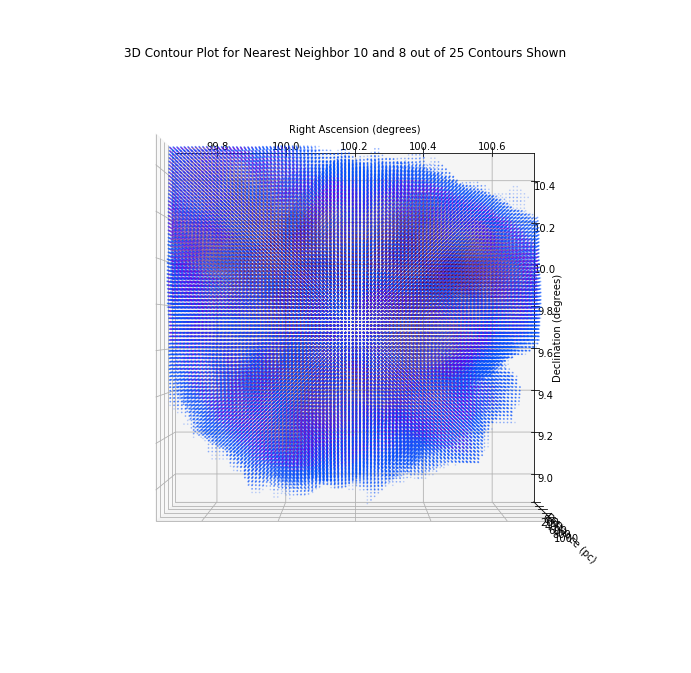

Elapsed Time: 77.2981014251709 seconds
Elapsed Time: 1.288301690419515 minutes


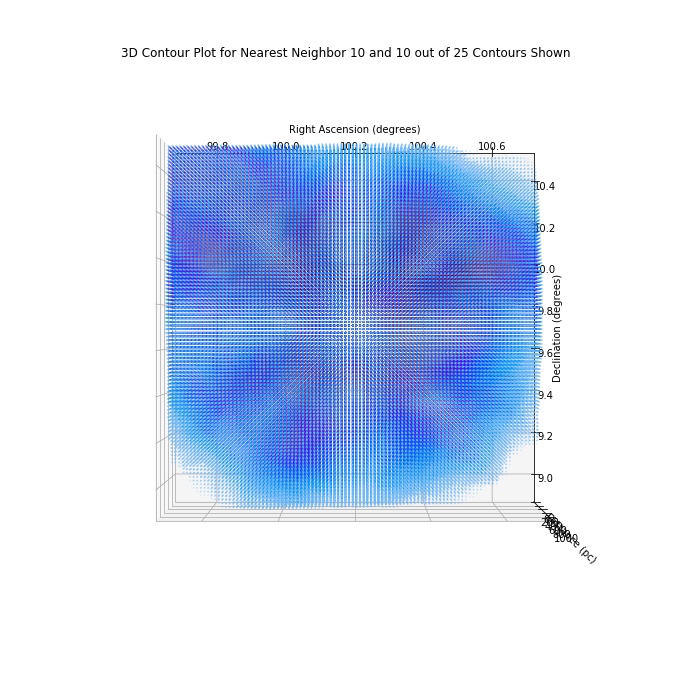

Elapsed Time: 112.00016355514526 seconds
Elapsed Time: 1.8666693925857545 minutes


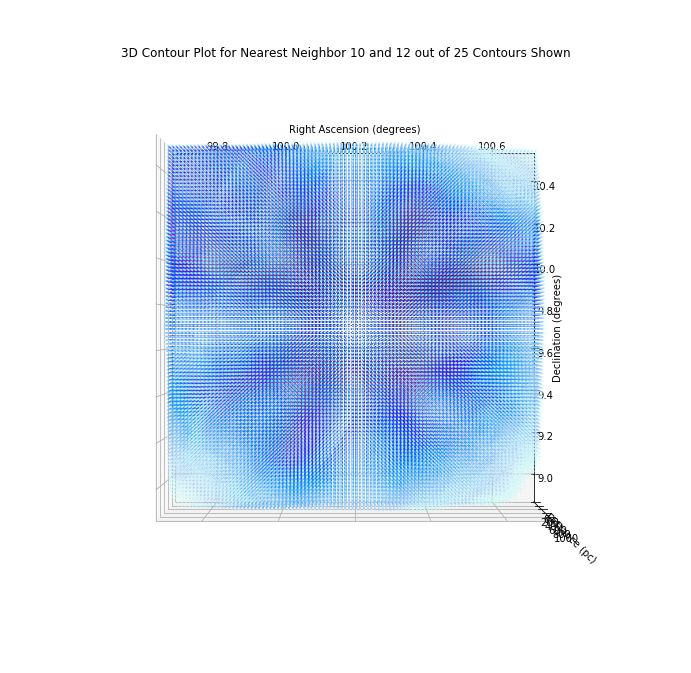

Elapsed Time: 137.8591227531433 seconds
Elapsed Time: 2.2976520458857217 minutes


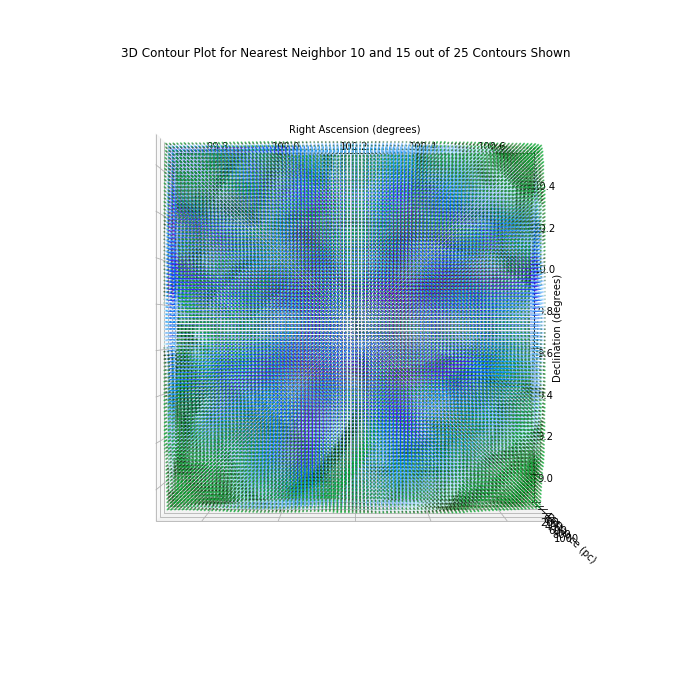

Elapsed Time: 159.8019893169403 seconds
Elapsed Time: 2.663366488615672 minutes


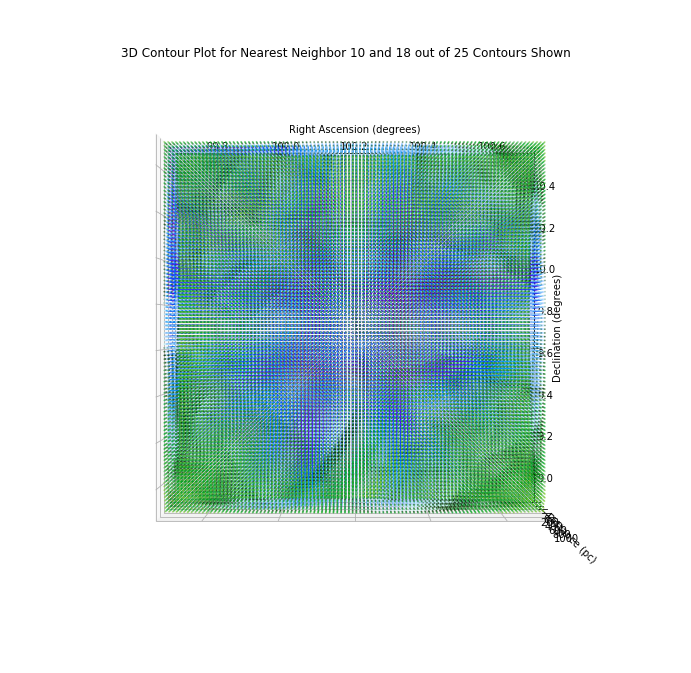

Elapsed Time: 172.3565273284912 seconds
Elapsed Time: 2.872608788808187 minutes


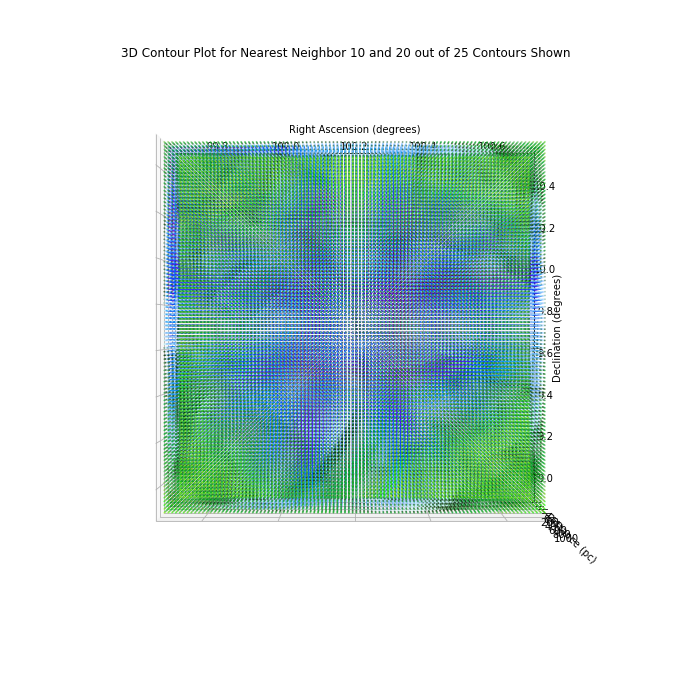

Elapsed Time: 237.23824048042297 seconds
Elapsed Time: 3.9539706746737164 minutes


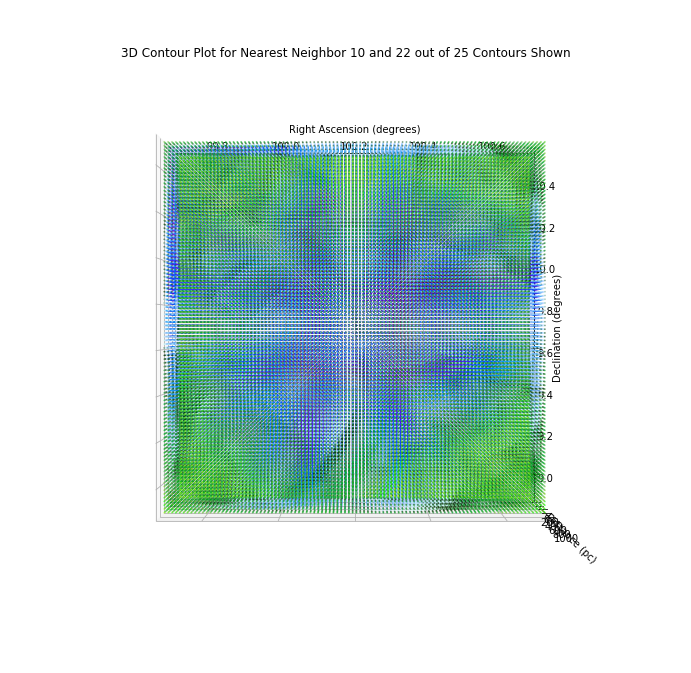

Elapsed Time: 365.56288743019104 seconds
Elapsed Time: 6.092714790503184 minutes


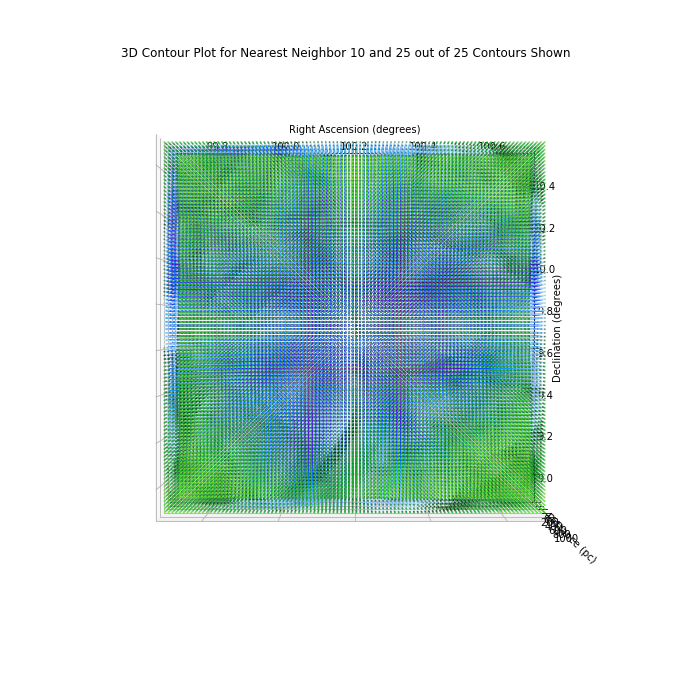

Elapsed Time: 213.1399703025818 seconds
Elapsed Time: 3.5523328383763633 minutes


In [52]:
xkcdColorsViridisAnalog=['xkcd:deep purple','xkcd:dark purple','xkcd:royal purple','xkcd:grape','xkcd:dark lavender','xkcd:blue violet','xkcd:electric blue','xkcd:azure','xkcd:sky blue','xkcd:powder blue','xkcd:pale blue','xkcd:dark green','xkcd:light forest green','xkcd:kelly green','xkcd:green','xkcd:soft green','xkcd:apple green','xkcd:electric green','xkcd:yellow green','xkcd:chartreuse','xkcd:light orange','xkcd:gold','xkcd:golden yellow','xkcd:yellowish','xkcd:yellow']
ColorVector=xkcdColorsViridisAnalog
n=25
q=2
theta=30
phi=-45
plt.rcParams['axes.facecolor']='white'
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=5
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=8
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=10
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=12
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=15
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=18
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=20
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=22
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
q=25
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)
theta=90
phi=-90
q=15
Distance3DMin,Distance3DMax,ContourLevels=Contour3D(n,q,ColorVector,theta,phi)

In [53]:
StarRA,StarDec,Gmag,Parallax,ParallaxError=Assignments(t)
StarDistance,DistanceAverage,DistanceStDev,Distance=SpectralDistances(M)

The columns within this catalog are: 
['_Glon', '_Glat', '_RAJ2000', '_DEJ2000', 'RA_ICRS', 'e_RA_ICRS', 'DE_ICRS', 'e_DE_ICRS', 'Source', 'Epoch', 'Plx', 'e_Plx', 'pmRA', 'e_pmRA', 'pmDE', 'e_pmDE', 'Dup', '__Gmag_', 'GLON', 'GLAT']


In [54]:
def RealisticCoordinates(StarDistance,StarDec,StarRA):
    #Transforms the distance, RA, and declination into spherical coordinates in units of parsecs (pc) and radians and then
    #changes the star coordinates into rectangular coordinates in space, which is the realistic picture
    #Parameter StarDistance is the array of distances to the stars in pc
    #Parameter StarDec is the array of star declinations in degrees
    #Parameter StarRA is the array of right ascensions of the stars in degrees
    tic=time.time()
    #Gets starting time
    Starrho=StarDistance
    #Assigns the star rho coordinates as the distance in parsecs (pc)
    NinetyDegrees=90*numpy.ones(len(StarDec))
    #Creates a vector of 90s the same length as the number of stars
    pi=math.pi
    #Renames pi so it is easier to use in calculations
    Startheta=(pi/180)*(NinetyDegrees-StarDec)
    #Computes the star theta coodinates in radians, where 0 radians is the celestial north pole and pi is the celestial equator
    Starphi=(pi/180)*StarRA
    #Computes the star phi coordinates in radians, where 0 radians is the RA of the vernal equinox
    Starx=numpy.array([])
    Stary=numpy.array([])
    Starz=numpy.array([])
    #Creates empty arrays for the x, y, and z coordinates in space
    rhoMin=min(Starrho)
    rhoMax=max(Starrho)
    thetaMin=min(Startheta)
    thetaMax=max(Startheta)
    phiMin=min(Starphi)
    phiMax=max(Starphi)
    #Computes minimum and maximum of each spherical coordinate
    for i in range(0,len(StarRA)):
        Starx=numpy.append(Starx,Starrho[i]*math.sin(Startheta[i])*math.cos(Starphi[i]))
        Stary=numpy.append(Stary,Starrho[i]*math.sin(Startheta[i])*math.sin(Starphi[i]))
        Starz=numpy.append(Starz,Starrho[i]*math.cos(Startheta[i]))
    #Uses spherical-to-rectangular coordinate transformation to find x, y, and z coordinates in space of the stars
    xMin=min(Starx)
    xMax=max(Starx)
    yMin=min(Stary)
    yMax=max(Stary)
    zMin=min(Starz)
    zMax=max(Starz)
    #Computes minimum and maximum of each rectangular coordinate
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (Starrho,pi,Startheta,Starphi,Starx,Stary,Starz,rhoMin,rhoMax,thetaMin,thetaMax,phiMin,phiMax,xMin,xMax,yMin,yMax,zMin,zMax)
Starrho,pi,Startheta,Starphi,Starx,Stary,Starz,rhoMin,rhoMax,thetaMin,thetaMax,phiMin,phiMax,xMin,xMax,yMin,yMax,zMin,zMax=RealisticCoordinates(StarDistance,StarDec,StarRA)

Elapsed Time: 22.158817529678345 seconds
Elapsed Time: 0.3693136254946391 minutes


In [55]:
def RealisticPixelSetup(Starrho,Startheta,Starphi,rhoMin,rhoMax,thetaMin,thetaMax,phiMin,phiMax,N):
    #
    #Parameter Starrho is the array of the star rho coordinates
    #Parameter Startheta is the array of the star theta coordinates
    #Parameter Starphi is the array of the star phi coordinates
    #Parameter rhoMin is the minimum of the star rho coordinates
    #Parameter rhoMax is the maximum of the star rho coordinates
    #Parameter thetaMin is the minimum of the star theta coordinates
    #Parameter thetaMax is the maximum of the star theta coordinates
    #Parameter phiMin is the minimum of the star phi coordinates
    #Parameter phiMax is the maximum of the star phi coordinates
    #Parameter N is the number of pixels desired for each coordinate
    tic=time.time()
    #Gets starting time
    rhoPixels=numpy.linspace(rhoMin,rhoMax,N)
    thetaPixels=numpy.linspace(thetaMin,thetaMax,N)
    phiPixels=numpy.linspace(phiMin,phiMax,N)
    NumberOfPoints=N**3
    PixelArray=numpy.zeros((NumberOfPoints,3))
    i=0
    for rho in rhoPixels:
        for theta in thetaPixels:
            for phi in phiPixels:
                PixelArray[i,0]=rho
                PixelArray[i,1]=theta
                PixelArray[i,2]=phi
                i+=1
    #
    rhoPixels=PixelArray[:,0]
    thetaPixels=PixelArray[:,1]
    phiPixels=PixelArray[:,2]
    xPixels=numpy.array([])
    yPixels=numpy.array([])
    zPixels=numpy.array([])
    for i in range(0,NumberOfPoints):
        xPixels=numpy.append(xPixels,rhoPixels[i]*math.sin(thetaPixels[i])*math.cos(phiPixels[i]))
        yPixels=numpy.append(yPixels,rhoPixels[i]*math.sin(thetaPixels[i])*math.sin(phiPixels[i]))
        zPixels=numpy.append(zPixels,rhoPixels[i]*math.cos(thetaPixels[i]))
    #
    xStDev=numpy.std(Starx)
    xAverage=numpy.average(Starx)
    x=Starx-xAverage
    x=x/xStDev
    #Shifts and normalizes the x coordinate
    yStDev=numpy.std(Stary)
    yAverage=numpy.average(Stary)
    y=Stary-yAverage
    y=y/yStDev
    #Shifts and normalizes the y coordinate
    zStDev=numpy.std(Starz)
    zAverage=numpy.average(Starz)
    z=Starz-zAverage
    z=z/zStDev
    #Shifts and normalizes the z coordinate
    xPix=xPixels-xAverage
    xPix=xPix/xStDev
    yPix=yPixels-yAverage
    yPix=yPix/yStDev
    zPix=zPixels-zAverage
    zPix=zPix/zStDev
    xPix=numpy.asarray(xPix)
    yPix=numpy.asarray(yPix)
    zPix=numpy.asarray(zPix)
    #
    RealisticPixels=numpy.zeros([N,N,N])
    #Makes three-dimensional array of zeros with N pixels on each side for use later on
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (NumberOfPoints,xPixels,yPixels,zPixels,xStDev,xAverage,x,yStDev,yAverage,y,zStDev,zAverage,z,xPix,yPix,zPix,RealisticPixels)
N=50
NumberOfPoints,xPixels,yPixels,zPixels,xStDev,xAverage,x,yStDev,yAverage,y,zStDev,zAverage,z,xPix,yPix,zPix,RealisticPixels=RealisticPixelSetup(Starrho,Startheta,Starphi,rhoMin,rhoMax,thetaMin,thetaMax,phiMin,phiMax,N)

Elapsed Time: 16.884791374206543 seconds
Elapsed Time: 0.281413189570109 minutes


In [56]:
def RealisticNearestNeighbor(x,y,z,k):
    #
    #Parameter x is the array of shifted and normalized star x coordinates
    #Parameter y 
    #
    tic=time.time()
    #Gets starting time
    RealisticStarArray=numpy.vstack((x,y,z))
    RealisticStarArray=numpy.transpose(RealisticStarArray)
    RealisticPixelArray=numpy.vstack((xPix,yPix,zPix))
    RealisticPixelArray=numpy.transpose(RealisticPixelArray)
    tree=spatial.cKDTree(RealisticStarArray)
    NumberOfNeighbors=k
    RealisticDistances,RealisticIndices=tree.query(RealisticPixelArray,k=[NumberOfNeighbors])
    #
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (RealisticStarArray,RealisticDistances,RealisticIndices)
RealisticStarArray,RealisticDistances,RealisticIndices=RealisticNearestNeighbor(x,y,z,k)

Elapsed Time: 0.37662744522094727 seconds
Elapsed Time: 0.006277124087015788 minutes


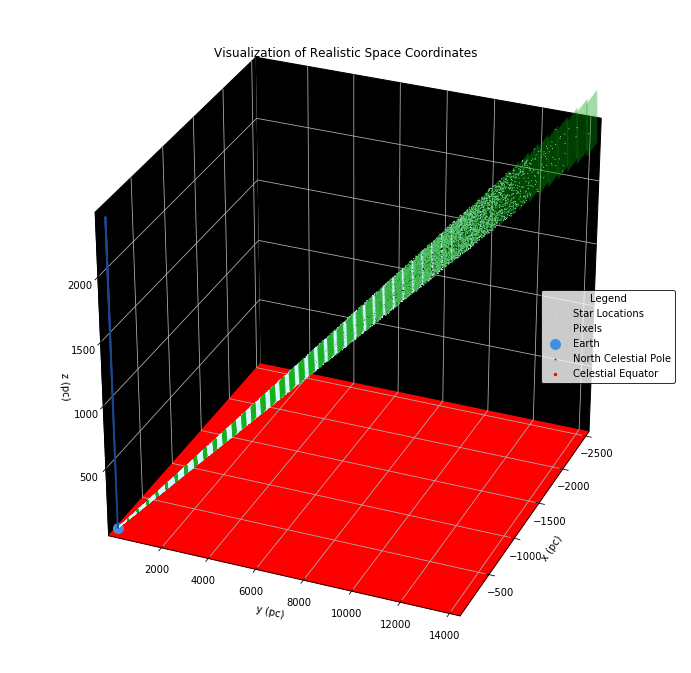

In [57]:
fig=plt.figure()
ax=fig.add_subplot(111,projection='3d')
#Creates a figure and makes the settings three-dimensional for plotting
plt.rcParams['axes.facecolor']='white'
plt.rcParams['figure.figsize']=12,12
ax.scatter3D(Starx,Stary,Starz,c='xkcd:pale blue',marker='*',s=1e-3,depthshade=True,alpha=1,label='Star Locations')
ax.scatter3D(xPixels,yPixels,zPixels,c='xkcd:green',marker='o',s=1e-3,depthshade=True,alpha=1,label='Pixels')
ax.scatter3D(0,0,0,c='xkcd:dark sky blue',marker='o',s=100,depthshade=False,alpha=1,label='Earth')
ax.scatter3D(numpy.zeros(1000),numpy.zeros(1000),numpy.linspace(0,zMax,1000),c='xkcd:cobalt',s=1,label='North Celestial Pole')
ax.scatter3D(-1000,2000,-10000,c='xkcd:red',marker='o',s=5,label='Celestial Equator')
'''ax.scatter3D(CelestialEquatorx,CelestialEquatory,CelestialEquatorz,c='xkcd:red',marker='o',s=0.1,depthshade=True,alpha=1)'''
ax.w_xaxis.set_pane_color((0,0,0,1))
ax.w_yaxis.set_pane_color((0,0,0,1))
ax.w_zaxis.set_pane_color((1,0,0,1))
plt.title('Visualization of Realistic Space Coordinates')
ax.set_xlabel('x (pc)')
ax.set_xlim([xMin,xMax])
ax.set_ylabel('y (pc)')
ax.set_ylim([yMin,yMax])
ax.set_zlabel('z (pc)')
ax.set_zlim([zMin,zMax])
ax.view_init(30,22.5)
ax.legend(loc='right',markerscale=1,title='Legend',edgecolor='black',facecolor='white')
plt.show()

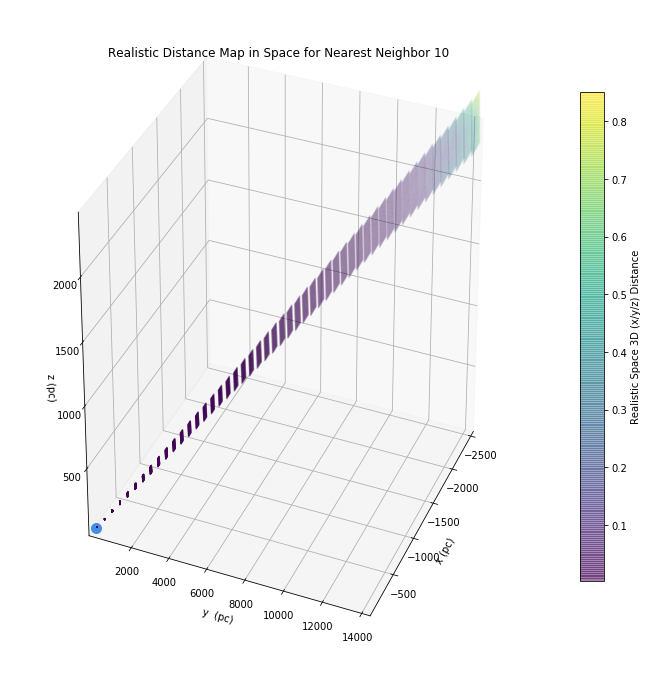

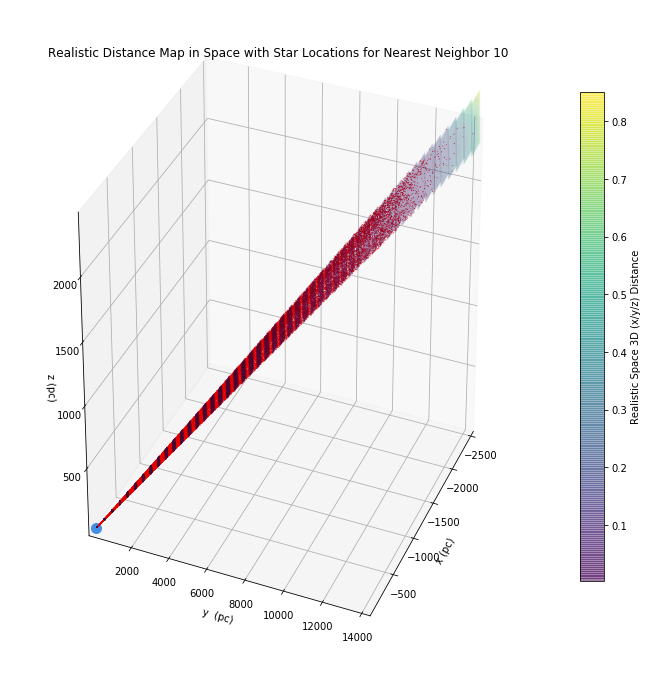

Elapsed Time: 20.9850013256073 seconds
Elapsed Time: 0.349750022093455 minutes


In [58]:
def RealisticDistanceMap(RealisticDistances):
    #
    #Parameter RealisticDistances is the array of realistic space kth nearest neighbor distances
    tic=time.time()
    #Gets starting time
    fig=plt.figure()
    ax=plt.axes(projection='3d')
    #Sets up a new figure and establishes the settings as three-dimensional
    plt.rcParams['figure.figsize']=12,12
    plt.rcParams['axes.facecolor']='white'
    #Sets the figure size and background color
    for x in range(0,N):
        for y in range(0,N):
            for z in range(0,N):
                RealisticPixels[x,y,z]=RealisticDistances[x+y+z]
    #Sets as each element in the 3D grid array the kth nearest realistic neighbor distance
    RealisticDistances=numpy.ndarray.flatten(RealisticDistances)
    #Flattens the realistic distances array into a one-dimensional vector for use as a color mapping
    RealisticMap=ax.scatter3D(xPixels,yPixels,zPixels,c=RealisticDistances,cmap='viridis',marker='o',s=1e-3,depthshade=True,alpha=0.5)
    #
    ax.scatter3D(0,0,0,c='xkcd:dark sky blue',marker='o',s=100,depthshade=False,alpha=1)
    #
    plt.title('Realistic Distance Map in Space for Nearest Neighbor %g'%(k))
    ax.set_xlabel('x (pc)')
    ax.set_xlim([xMin,xMax])
    ax.set_ylabel('y  (pc)')
    ax.set_ylim([yMin,yMax])
    ax.set_zlabel('z (pc)')
    ax.set_zlim([zMin,zMax])
    #Makes appropriate title, axis labels, and limits for variables
    cbar=fig.colorbar(RealisticMap,shrink=0.75)
    cbar.set_label('Realistic Space 3D (x/y/z) Distance',rotation='90')
    #Adds a color bar for the realistic kth nearest neighbor distance, labels it, and rotates the label
    ax.view_init(30,22.5)
    #
    plt.show()
    fig=plt.figure()
    ax=plt.axes(projection='3d')
    #Creates another figure and reestablished 3D axis settings
    RealisticMap=ax.scatter3D(xPixels,yPixels,zPixels,c=RealisticDistances,cmap='viridis',marker='o',s=1e-3,depthshade=True,alpha=0.5)
    cbar=fig.colorbar(RealisticMap,shrink=0.75)
    cbar.set_label('Realistic Space 3D (x/y/z) Distance',rotation='90')
    #Adds a color bar for the realistic kth nearest neighbor distance, labels it, and rotates the label
    ax.scatter3D(Starx,Stary,Starz,c='xkcd:red',marker='*',s=1e-3,depthshade=True)
    #Plots the realistic positions of all stars as white stars with opacity varying to show depth
    ax.scatter3D(0,0,0,c='xkcd:dark sky blue',marker='o',s=100,depthshade=False,alpha=1)
    #
    plt.title('Realistic Distance Map in Space with Star Locations for Nearest Neighbor %g'%(k))
    ax.set_xlabel('x (pc)')
    ax.set_xlim([xMin,xMax])
    ax.set_ylabel('y  (pc)')
    ax.set_ylim([yMin,yMax])
    ax.set_zlabel('z (pc)')
    ax.set_zlim([zMin,zMax])
    #Makes appropriate title, axis labels, and limits for variables
    ax.view_init(30,22.5)
    #
    plt.show()
    toc=time.time()
    #Gets final time
    ElapsedTime=toc-tic
    ElapsedTimeMinutes=ElapsedTime/60
    print('Elapsed Time:',ElapsedTime,'seconds')
    print('Elapsed Time:',ElapsedTimeMinutes,'minutes')
    #Shows how long the function took to run
    return (RealisticPixels)
plt.rcParams['figure.figsize']=12,12
plt.rcParams['axes.facecolor']='white'
#Sets the figure size and background color
RealisticPixels=RealisticDistanceMap(RealisticDistances)

In [59]:
print('Star x-Coordinate Minimum:',xMin,'pc')
print('Star x-Coordinate Maximum:',xMax,'pc')
print('Star y-Coordinate Minimum:',yMin,'pc')
print('Star y-Coordinate Maximum:',yMax,'pc')
print('Star z-Coordinate Minimum:',zMin,'pc')
print('Star z-Coordinate Maximum:',zMax,'pc')

Star x-Coordinate Minimum: -2519.577098651482 pc
Star x-Coordinate Maximum: -3.50075036867433 pc
Star y-Coordinate Minimum: 19.284025832220728 pc
Star y-Coordinate Maximum: 14133.933170523023 pc
Star z-Coordinate Minimum: 3.098825654314191 pc
Star z-Coordinate Maximum: 2435.816091987901 pc
